In [1]:
import pandas as pd
import numpy as np
import json
import seaborn as sns
from collections import Counter

In [2]:
with open('train.json', 'r') as f:
    data = json.load(f)

In [3]:
test = pd.read_csv('test.csv')

In [4]:
testlog = list(test[' Log'])

In [5]:
len(testlog)

595300

In [6]:
count = 0
for i in testlog:
    if 'RAS APP FATAL ciod: failed to read message prefix on control stream' in i:
        count += 1
count

5983

In [7]:
keys = [key for key in data.keys()]

In [8]:
values = [value for value in data.values()]

In [9]:
len(keys)

4152659

In [11]:
keysStripped = []

In [12]:
for i in keys:
    keysStripped.append(i.strip())

In [13]:
keysF = []
for i in keysStripped:
    keysF.append(i.split(" ", 5))

In [14]:
df = pd.DataFrame(keysF, columns=['1', 'Date', 'Info' ,'UID', 'Info2', 'Error'])

In [15]:
df['Target'] =  values

In [16]:
testvals = []
for i in testlog:
    testvals.append(i.strip().split(" ", 5))

In [17]:
testlog = []
for i in testvals:
    testlog.append(str(i[1] + " " + i[-1]))

In [18]:
testlog

['2005.08.17 RAS KERNEL FATAL rts: kernel terminated for reason 1001',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.05 RAS KERNEL INFO generating core.6463',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.06 RAS KERNEL INFO CE sym 35, at 0x06a7bd60, mask 0x40',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.07 RAS KERNEL INFO generating core.2364',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.07 RAS KERNEL INFO ciod: Message code 0 is not 51 or 4294967295',
 '2005.06.03 RAS KERNEL INFO generating core.228',
 '2005.06.06 RAS KERNEL INFO instruction cache parity error corrected',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.05 RAS KERNEL INFO generating core.4279',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',
 '2005.06.05 RAS KERNEL INFO generating core.7572',
 '2005.06.11 RAS KERNEL FATAL data TLB error interrupt',

In [20]:
df

,1,Date,Info,UID,Info2,Error,Target
0,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.363779,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
1,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.527847,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
2,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.675872,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
3,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.823719,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
4,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.982731,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
...,...,...,...,...,...,...,...
4152654,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.386651,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152655,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.558220,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152656,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.675784,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152657,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.777307,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal


In [21]:
abnormal_codes = list(set(df[df['Target'] == 'abnormal']['Info2']))
normal_codes = list(set(df[df['Target'] == 'normal']['Info2']))

In [22]:
df[df['Target'] == 'abnormal']['Info2'].value_counts()

R30-M0-N9-C:J16-U01    66917
R22-M0-N7-C:J04-U01        6
R22-M0-N7-C:J09-U01        6
R34-M1-NC-I:J18-U01        5
R34-M1-N8-I:J18-U01        5
                       ...  
R24-M0-NE-C:J13-U01        1
R24-M0-N5-C:J02-U11        1
R24-M1-NB-C:J04-U11        1
R21-M1-NE-C:J09-U01        1
R21-M1-N1-C:J07-U11        1
Name: Info2, Length: 1012, dtype: int64

In [23]:
abnormal_codes = list(abnormal_codes)
normal_codes = list(normal_codes)

In [346]:
error_inf = list(df['Info2'])

In [371]:
abnormal_codes.sort()
normal_codes.sort()

In [354]:
len(abnormal_codes), len(normal_codes)

(69692, 4082967)

In [364]:
len(set(abnormal_codes)), len(set(normal_codes))

(32, 72)

In [376]:
sim = []
count = {}
for code in set(abnormal_codes):
    for code1 in normal_codes:
        if code == code1:
            if code in count:
                count[code] += 1
            else:
                count[code] = 1

In [382]:
count

{'R36': 107855,
 'R17': 66493,
 'R37': 107661,
 'R31': 99839,
 'R03': 49053,
 'R12': 67577,
 'R10': 76823,
 'R20': 154788,
 'R01': 68941,
 'R02': 133526,
 'R15': 65965,
 'R05': 66618,
 'R25': 142429,
 'R32': 96213,
 'R06': 62853,
 'R34': 101674,
 'R16': 83546,
 'R13': 63954,
 'R30': 100699,
 'R23': 102626,
 'R11': 60691,
 'R21': 145562,
 'R26': 165033,
 'R22': 126970,
 'R24': 147992,
 'R35': 96552,
 'R00': 76156,
 'R27': 147550,
 'R04': 66033,
 'R33': 101789,
 'R07': 49948,
 'R14': 66657}

In [281]:
error_unique = df['Error'].unique()

In [341]:
for error in error_unique:
    print(error)

RAS KERNEL INFO instruction cache parity error corrected
RAS LINKCARD INFO MidplaneSwitchController performing bit sparing on R27-M1-L3-U18-C bit 3
RAS KERNEL INFO generating core.304
RAS KERNEL INFO generating core.17
RAS KERNEL INFO generating core.784
RAS KERNEL INFO generating core.253
RAS KERNEL INFO generating core.320
RAS KERNEL INFO generating core.65
RAS KERNEL INFO generating core.3616
RAS KERNEL INFO generating core.1024
RAS KERNEL INFO generating core.3585
RAS KERNEL INFO generating core.15
RAS KERNEL INFO generating core.270
RAS KERNEL INFO generating core.3889
RAS KERNEL INFO generating core.66
RAS KERNEL INFO generating core.67
RAS KERNEL INFO generating core.263
RAS KERNEL INFO generating core.238
RAS KERNEL INFO 1 ddr errors(s) detected and corrected on rank 0, symbol 0, bit 3
RAS KERNEL INFO 3450051 L3 EDRAM error(s) (dcr 0x0157) detected and corrected
RAS KERNEL INFO CE sym 0, at 0x0b8580c0, mask 0x10
RAS KERNEL INFO total of 1 ddr error(s) detected and corrected
RAS

RAS KERNEL INFO generating core.404
RAS KERNEL INFO generating core.461
RAS KERNEL INFO generating core.452
RAS KERNEL INFO generating core.399
RAS KERNEL INFO generating core.511
RAS KERNEL INFO generating core.510
RAS KERNEL INFO generating core.420
RAS KERNEL INFO generating core.485
RAS KERNEL INFO generating core.190
RAS KERNEL INFO generating core.182
RAS KERNEL INFO generating core.165
RAS KERNEL INFO generating core.150
RAS KERNEL INFO generating core.140
RAS KERNEL INFO generating core.570
RAS KERNEL INFO generating core.632
RAS KERNEL INFO generating core.633
RAS KERNEL INFO generating core.627
RAS KERNEL INFO generating core.624
RAS KERNEL INFO generating core.560
RAS KERNEL INFO generating core.554
RAS KERNEL INFO generating core.608
RAS KERNEL INFO generating core.609
RAS KERNEL INFO generating core.610
RAS KERNEL INFO generating core.611
RAS KERNEL INFO generating core.856
RAS KERNEL INFO generating core.857
RAS KERNEL INFO generating core.792
RAS KERNEL INFO generating c

RAS KERNEL INFO generating core.4554
RAS KERNEL INFO generating core.4297
RAS KERNEL INFO generating core.4544
RAS KERNEL INFO generating core.4288
RAS KERNEL INFO generating core.4545
RAS KERNEL INFO generating core.4289
RAS KERNEL INFO generating core.4290
RAS KERNEL INFO generating core.4291
RAS KERNEL INFO generating core.4546
RAS KERNEL INFO generating core.4299
RAS KERNEL INFO generating core.4547
RAS KERNEL INFO generating core.4555
RAS KERNEL INFO generating core.6778
RAS KERNEL INFO generating core.7032
RAS KERNEL INFO generating core.7033
RAS KERNEL INFO generating core.6777
RAS KERNEL INFO generating core.6776
RAS KERNEL INFO generating core.6771
RAS KERNEL INFO generating core.7027
RAS KERNEL INFO generating core.6779
RAS KERNEL INFO generating core.7035
RAS KERNEL INFO generating core.7034
RAS KERNEL INFO generating core.7024
RAS KERNEL INFO generating core.6768
RAS KERNEL INFO generating core.7025
RAS KERNEL INFO generating core.7026
RAS KERNEL INFO generating core.6769
R

RAS KERNEL INFO generating core.14120
RAS KERNEL INFO generating core.14121
RAS KERNEL INFO generating core.13609
RAS KERNEL INFO generating core.13610
RAS KERNEL INFO generating core.13592
RAS KERNEL INFO generating core.13594
RAS KERNEL INFO generating core.14104
RAS KERNEL INFO generating core.14105
RAS KERNEL INFO generating core.14106
RAS KERNEL INFO generating core.13593
RAS KERNEL INFO generating core.14088
RAS KERNEL INFO generating core.13576
RAS KERNEL INFO generating core.14089
RAS KERNEL INFO generating core.13577
RAS KERNEL INFO generating core.13578
RAS KERNEL INFO generating core.14090
RAS KERNEL INFO generating core.13595
RAS KERNEL INFO generating core.14091
RAS KERNEL INFO generating core.14107
RAS KERNEL INFO generating core.10552
RAS KERNEL INFO generating core.10539
RAS KERNEL INFO generating core.10555
RAS KERNEL INFO generating core.11067
RAS KERNEL INFO generating core.11050
RAS KERNEL INFO generating core.10537
RAS KERNEL INFO generating core.10520
RAS KERNEL I

RAS KERNEL INFO generating core.9433
RAS KERNEL INFO generating core.9432
RAS KERNEL INFO generating core.9691
RAS KERNEL INFO generating core.9682
RAS KERNEL INFO generating core.9425
RAS KERNEL INFO generating core.9673
RAS KERNEL INFO generating core.9674
RAS KERNEL INFO generating core.9417
RAS KERNEL INFO generating core.9665
RAS KERNEL INFO generating core.9666
RAS KERNEL INFO generating core.9667
RAS KERNEL INFO generating core.9438
RAS KERNEL INFO generating core.9693
RAS KERNEL INFO generating core.9687
RAS KERNEL INFO generating core.9684
RAS KERNEL INFO generating core.9676
RAS KERNEL INFO generating core.9677
RAS KERNEL INFO generating core.9412
RAS KERNEL INFO generating core.9670
RAS KERNEL INFO generating core.13661
RAS KERNEL INFO generating core.13407
RAS KERNEL INFO generating core.13663
RAS KERNEL INFO generating core.13398
RAS KERNEL INFO generating core.13644
RAS KERNEL INFO generating core.13636
RAS KERNEL INFO generating core.13381
RAS KERNEL INFO generating core

RAS KERNEL INFO generating core.11889
RAS KERNEL INFO generating core.12128
RAS KERNEL INFO generating core.16277
RAS KERNEL INFO generating core.16269
RAS KERNEL INFO generating core.16013
RAS KERNEL INFO generating core.10782
RAS KERNEL INFO generating core.11038
RAS KERNEL INFO generating core.11021
RAS KERNEL INFO generating core.10758
RAS KERNEL INFO generating core.13020
RAS KERNEL INFO generating core.13268
RAS KERNEL INFO generating core.13013
RAS KERNEL INFO generating core.13006
RAS KERNEL INFO generating core.13007
RAS KERNEL INFO generating core.13263
RAS KERNEL INFO generating core.15013
RAS KERNEL INFO generating core.11006
RAS KERNEL INFO generating core.11261
RAS KERNEL INFO generating core.11005
RAS KERNEL INFO generating core.11004
RAS KERNEL INFO generating core.11007
RAS KERNEL INFO generating core.11263
RAS KERNEL INFO generating core.10996
RAS KERNEL INFO generating core.10997
RAS KERNEL INFO generating core.10998
RAS KERNEL INFO generating core.10990
RAS KERNEL I

RAS KERNEL INFO generating core.11925
RAS KERNEL INFO generating core.11397
RAS KERNEL INFO generating core.9975
RAS KERNEL INFO generating core.9444
RAS KERNEL INFO generating core.9428
RAS KERNEL INFO generating core.9415
RAS KERNEL INFO generating core.14196
RAS KERNEL INFO generating core.13671
RAS KERNEL INFO generating core.14198
RAS KERNEL INFO generating core.14164
RAS KERNEL INFO generating core.12220
RAS KERNEL INFO generating core.12221
RAS KERNEL INFO generating core.11711
RAS KERNEL INFO generating core.12205
RAS KERNEL INFO generating core.12174
RAS KERNEL INFO generating core.12191
RAS KERNEL INFO generating core.13493
RAS KERNEL INFO generating core.13479
RAS KERNEL INFO generating core.14007
RAS KERNEL INFO generating core.13988
RAS KERNEL INFO generating core.13990
RAS KERNEL INFO generating core.13477
RAS KERNEL INFO generating core.13462
RAS KERNEL INFO generating core.13446
RAS KERNEL INFO generating core.13447
RAS KERNEL INFO generating core.11774
RAS KERNEL INFO 

NULL DISCOVERY WARNING Node card VPD check: U01 node in processor card slot J09 do not match. VPD ecid 04D78091962FFFFF0C071BC046E4, found 074A04E28C7BFFFF0B081C008CEB
NULL DISCOVERY WARNING Node card VPD check: U11 node in processor card slot J09 do not match. VPD ecid 04DA8091C22FFFFF0C051C2050EA, found 075304E2047BFFFF09091C2086ED
NULL DISCOVERY WARNING Node card VPD check: U01 node in processor card slot J02 do not match. VPD ecid 07420D019D2FFFFF080D1B308ED7, found 074B0D98E12FFFFF0D0D1BE046E8
NULL DISCOVERY WARNING Node card VPD check: U11 node in processor card slot J02 do not match. VPD ecid 07620D00D02FFFFF060C1B7046DB, found 075C0D52212FFFFF020C1AD0CED1
NULL DISCOVERY WARNING Node card VPD check: U01 node in processor card slot J08 do not match. VPD ecid 07470D48462FFFFF0E0E1B7114DD, found 04CD7DB7207BFFFF05041BA08EE0
NULL DISCOVERY WARNING Node card VPD check: U11 node in processor card slot J08 do not match. VPD ecid 074D0D48402FFFFF0A071B2084D7, found 04C07DB6DC7BFFFF04041

RAS KERNEL INFO 37378496 double-hummer alignment exceptions
RAS KERNEL INFO 36581808 double-hummer alignment exceptions
RAS KERNEL INFO 40284512 double-hummer alignment exceptions
RAS KERNEL INFO 34066368 double-hummer alignment exceptions
RAS KERNEL INFO 24065824 double-hummer alignment exceptions
RAS KERNEL INFO 28281344 double-hummer alignment exceptions
RAS KERNEL INFO 31631600 double-hummer alignment exceptions
RAS KERNEL INFO 26382272 double-hummer alignment exceptions
RAS KERNEL INFO 19609312 double-hummer alignment exceptions
RAS KERNEL INFO 40013664 double-hummer alignment exceptions
RAS KERNEL INFO 33643680 double-hummer alignment exceptions
RAS KERNEL INFO 46852512 double-hummer alignment exceptions
RAS KERNEL INFO 19817520 double-hummer alignment exceptions
RAS KERNEL INFO 21565360 double-hummer alignment exceptions
RAS KERNEL INFO 33342384 double-hummer alignment exceptions
RAS KERNEL INFO 27004128 double-hummer alignment exceptions
RAS KERNEL INFO 47426688 double-hummer a

RAS KERNEL INFO 739806256 double-hummer alignment exceptions
RAS KERNEL INFO 751172560 double-hummer alignment exceptions
RAS KERNEL INFO 753921920 double-hummer alignment exceptions
RAS KERNEL INFO 758561904 double-hummer alignment exceptions
RAS KERNEL INFO 762468112 double-hummer alignment exceptions
RAS KERNEL INFO 753692576 double-hummer alignment exceptions
RAS KERNEL INFO 741485616 double-hummer alignment exceptions
RAS KERNEL INFO 751869904 double-hummer alignment exceptions
RAS KERNEL INFO 767430704 double-hummer alignment exceptions
RAS KERNEL INFO 760037584 double-hummer alignment exceptions
RAS KERNEL INFO 755879776 double-hummer alignment exceptions
RAS KERNEL INFO 767826208 double-hummer alignment exceptions
RAS KERNEL INFO 766642064 double-hummer alignment exceptions
RAS KERNEL INFO 753217536 double-hummer alignment exceptions
RAS KERNEL INFO 734532528 double-hummer alignment exceptions
RAS KERNEL INFO 745772768 double-hummer alignment exceptions
RAS KERNEL INFO 74161198

RAS KERNEL INFO 759018576 double-hummer alignment exceptions
RAS KERNEL INFO 752196352 double-hummer alignment exceptions
RAS KERNEL INFO 772663376 double-hummer alignment exceptions
RAS KERNEL INFO 753341856 double-hummer alignment exceptions
RAS KERNEL INFO 748857888 double-hummer alignment exceptions
RAS KERNEL INFO 751575888 double-hummer alignment exceptions
RAS KERNEL INFO 752434800 double-hummer alignment exceptions
RAS KERNEL INFO 745726912 double-hummer alignment exceptions
RAS KERNEL INFO 749714656 double-hummer alignment exceptions
RAS KERNEL INFO 742661840 double-hummer alignment exceptions
RAS KERNEL INFO 760060064 double-hummer alignment exceptions
RAS KERNEL INFO 779693264 double-hummer alignment exceptions
RAS KERNEL INFO 757364704 double-hummer alignment exceptions
RAS KERNEL INFO 758138272 double-hummer alignment exceptions
RAS KERNEL INFO 768973536 double-hummer alignment exceptions
RAS KERNEL INFO 743821056 double-hummer alignment exceptions
RAS KERNEL INFO 74775332

RAS KERNEL INFO 255250286 double-hummer alignment exceptions
RAS KERNEL INFO 255180073 double-hummer alignment exceptions
RAS KERNEL INFO 257649546 double-hummer alignment exceptions
RAS KERNEL INFO 255651757 double-hummer alignment exceptions
RAS KERNEL INFO 255606608 double-hummer alignment exceptions
RAS KERNEL INFO 258913442 double-hummer alignment exceptions
RAS KERNEL INFO 257676358 double-hummer alignment exceptions
RAS KERNEL INFO 258865190 double-hummer alignment exceptions
RAS KERNEL INFO 256921536 double-hummer alignment exceptions
RAS KERNEL INFO 259301393 double-hummer alignment exceptions
RAS KERNEL INFO 256235524 double-hummer alignment exceptions
RAS KERNEL INFO 258609351 double-hummer alignment exceptions
RAS KERNEL INFO 257870706 double-hummer alignment exceptions
RAS KERNEL INFO 256043375 double-hummer alignment exceptions
RAS KERNEL INFO 259104852 double-hummer alignment exceptions
RAS KERNEL INFO 256550661 double-hummer alignment exceptions
RAS KERNEL INFO 25480567

RAS KERNEL INFO 257433158 double-hummer alignment exceptions
RAS KERNEL INFO 256873984 double-hummer alignment exceptions
RAS KERNEL INFO 254427698 double-hummer alignment exceptions
RAS KERNEL INFO 253242778 double-hummer alignment exceptions
RAS KERNEL INFO 258135828 double-hummer alignment exceptions
RAS KERNEL INFO 256882247 double-hummer alignment exceptions
RAS KERNEL INFO 259479207 double-hummer alignment exceptions
RAS KERNEL INFO 256672973 double-hummer alignment exceptions
RAS KERNEL INFO 258719609 double-hummer alignment exceptions
RAS KERNEL INFO 257041720 double-hummer alignment exceptions
RAS KERNEL INFO 255179970 double-hummer alignment exceptions
RAS KERNEL INFO 255539224 double-hummer alignment exceptions
RAS KERNEL INFO 258963413 double-hummer alignment exceptions
RAS KERNEL INFO 250612632 double-hummer alignment exceptions
RAS KERNEL INFO 259112638 double-hummer alignment exceptions
RAS KERNEL INFO 262626407 double-hummer alignment exceptions
RAS KERNEL INFO 25927998

RAS KERNEL INFO 262285306 double-hummer alignment exceptions
RAS KERNEL INFO 257581602 double-hummer alignment exceptions
RAS KERNEL INFO 255917091 double-hummer alignment exceptions
RAS KERNEL INFO 255277591 double-hummer alignment exceptions
RAS KERNEL INFO 255708789 double-hummer alignment exceptions
RAS KERNEL INFO 257622567 double-hummer alignment exceptions
RAS KERNEL INFO 257105253 double-hummer alignment exceptions
RAS KERNEL INFO 257606984 double-hummer alignment exceptions
RAS KERNEL INFO 256413399 double-hummer alignment exceptions
RAS KERNEL INFO 256704755 double-hummer alignment exceptions
RAS KERNEL INFO 257187354 double-hummer alignment exceptions
RAS KERNEL INFO 257167395 double-hummer alignment exceptions
RAS KERNEL INFO 257349094 double-hummer alignment exceptions
RAS KERNEL INFO 257680653 double-hummer alignment exceptions
RAS KERNEL INFO 253706192 double-hummer alignment exceptions
RAS KERNEL INFO 257606864 double-hummer alignment exceptions
RAS KERNEL INFO 25574422

RAS KERNEL INFO 258644158 double-hummer alignment exceptions
RAS KERNEL INFO 253016677 double-hummer alignment exceptions
RAS KERNEL INFO 255533744 double-hummer alignment exceptions
RAS KERNEL INFO 256486225 double-hummer alignment exceptions
RAS KERNEL INFO 255604612 double-hummer alignment exceptions
RAS KERNEL INFO 254583999 double-hummer alignment exceptions
RAS KERNEL INFO 253843103 double-hummer alignment exceptions
RAS KERNEL INFO 254767597 double-hummer alignment exceptions
RAS KERNEL INFO 260870192 double-hummer alignment exceptions
RAS KERNEL INFO 257294080 double-hummer alignment exceptions
RAS KERNEL INFO 257621291 double-hummer alignment exceptions
RAS KERNEL INFO 257971460 double-hummer alignment exceptions
RAS KERNEL INFO 256618370 double-hummer alignment exceptions
RAS KERNEL INFO 255935891 double-hummer alignment exceptions
RAS KERNEL INFO 256625805 double-hummer alignment exceptions
RAS KERNEL INFO 254274055 double-hummer alignment exceptions
RAS KERNEL INFO 25830913

RAS KERNEL INFO 254284106 double-hummer alignment exceptions
RAS KERNEL INFO 256802972 double-hummer alignment exceptions
RAS KERNEL INFO 252000464 double-hummer alignment exceptions
RAS KERNEL INFO 254873270 double-hummer alignment exceptions
RAS KERNEL INFO 259988514 double-hummer alignment exceptions
RAS KERNEL INFO 255635677 double-hummer alignment exceptions
RAS KERNEL INFO 256323540 double-hummer alignment exceptions
RAS KERNEL INFO 259375313 double-hummer alignment exceptions
RAS KERNEL INFO 254997081 double-hummer alignment exceptions
RAS KERNEL INFO 256323265 double-hummer alignment exceptions
RAS KERNEL INFO 259567104 double-hummer alignment exceptions
RAS KERNEL INFO 253733893 double-hummer alignment exceptions
RAS KERNEL INFO 255416710 double-hummer alignment exceptions
RAS KERNEL INFO 255918671 double-hummer alignment exceptions
RAS KERNEL INFO 258612491 double-hummer alignment exceptions
RAS KERNEL INFO 257303338 double-hummer alignment exceptions
RAS KERNEL INFO 25635551

RAS KERNEL INFO generating core.58016
RAS KERNEL INFO generating core.25344
RAS KERNEL INFO generating core.58112
RAS KERNEL INFO generating core.29440
RAS KERNEL INFO generating core.62208
RAS KERNEL INFO generating core.25088
RAS KERNEL INFO generating core.57856
RAS KERNEL INFO generating core.20616
RAS KERNEL INFO generating core.53384
RAS KERNEL INFO generating core.64257
RAS KERNEL INFO generating core.53376
RAS KERNEL INFO generating core.53377
RAS KERNEL INFO generating core.16512
RAS KERNEL INFO generating core.49280
RAS KERNEL INFO generating core.16513
RAS KERNEL INFO generating core.49281
RAS KERNEL INFO generating core.53761
RAS KERNEL INFO generating core.16768
RAS KERNEL INFO generating core.49536
RAS KERNEL INFO generating core.22784
RAS KERNEL INFO generating core.55552
RAS KERNEL INFO generating core.51233
RAS KERNEL INFO generating core.16389
RAS KERNEL INFO generating core.49157
RAS KERNEL INFO generating core.25473
RAS KERNEL INFO generating core.58241
RAS KERNEL I

RAS KERNEL INFO generating core.57532
RAS KERNEL INFO generating core.24766
RAS KERNEL INFO generating core.57534
RAS KERNEL INFO generating core.25788
RAS KERNEL INFO generating core.58556
RAS KERNEL INFO generating core.25789
RAS KERNEL INFO generating core.58557
RAS KERNEL INFO generating core.25790
RAS KERNEL INFO generating core.58558
RAS KERNEL INFO generating core.24765
RAS KERNEL INFO generating core.57533
RAS KERNEL INFO generating core.25756
RAS KERNEL INFO generating core.58524
RAS KERNEL INFO generating core.24732
RAS KERNEL INFO generating core.57500
RAS KERNEL INFO generating core.25757
RAS KERNEL INFO generating core.58525
RAS KERNEL INFO generating core.24733
RAS KERNEL INFO generating core.57501
RAS KERNEL INFO generating core.24734
RAS KERNEL INFO generating core.57502
RAS KERNEL INFO generating core.24735
RAS KERNEL INFO generating core.57503
RAS KERNEL INFO generating core.25758
RAS KERNEL INFO generating core.58526
RAS KERNEL INFO generating core.24767
RAS KERNEL I

RAS KERNEL INFO generating core.20632
RAS KERNEL INFO generating core.53400
RAS KERNEL INFO generating core.54425
RAS KERNEL INFO generating core.20633
RAS KERNEL INFO generating core.53401
RAS KERNEL INFO generating core.20634
RAS KERNEL INFO generating core.53402
RAS KERNEL INFO generating core.20635
RAS KERNEL INFO generating core.53403
RAS KERNEL INFO generating core.54426
RAS KERNEL INFO generating core.20667
RAS KERNEL INFO generating core.53435
RAS KERNEL INFO generating core.54427
RAS KERNEL INFO generating core.54459
RAS KERNEL INFO generating core.37630
RAS KERNEL INFO generating core.38652
RAS KERNEL INFO generating core.38653
RAS KERNEL INFO generating core.37629
RAS KERNEL INFO generating core.37628
RAS KERNEL INFO generating core.37599
RAS KERNEL INFO generating core.38623
RAS KERNEL INFO generating core.37631
RAS KERNEL INFO generating core.38655
RAS KERNEL INFO generating core.38654
RAS KERNEL INFO generating core.38620
RAS KERNEL INFO generating core.37596
RAS KERNEL I

RAS KERNEL INFO generating core.57879
RAS KERNEL INFO generating core.58902
RAS KERNEL INFO generating core.25143
RAS KERNEL INFO generating core.57911
RAS KERNEL INFO generating core.26135
RAS KERNEL INFO generating core.58903
RAS KERNEL INFO generating core.58935
RAS KERNEL INFO generating core.45174
RAS KERNEL INFO generating core.46196
RAS KERNEL INFO generating core.46197
RAS KERNEL INFO generating core.45173
RAS KERNEL INFO generating core.45172
RAS KERNEL INFO generating core.45143
RAS KERNEL INFO generating core.46167
RAS KERNEL INFO generating core.45175
RAS KERNEL INFO generating core.46199
RAS KERNEL INFO generating core.46198
RAS KERNEL INFO generating core.46164
RAS KERNEL INFO generating core.45140
RAS KERNEL INFO generating core.46165
RAS KERNEL INFO generating core.46166
RAS KERNEL INFO generating core.45141
RAS KERNEL INFO generating core.45142
RAS KERNEL INFO generating core.45108
RAS KERNEL INFO generating core.45110
RAS KERNEL INFO generating core.46132
RAS KERNEL I

RAS KERNEL INFO generating core.54772
RAS KERNEL INFO generating core.22005
RAS KERNEL INFO generating core.54773
RAS KERNEL INFO generating core.20981
RAS KERNEL INFO generating core.53749
RAS KERNEL INFO generating core.20980
RAS KERNEL INFO generating core.53748
RAS KERNEL INFO generating core.20951
RAS KERNEL INFO generating core.53719
RAS KERNEL INFO generating core.21975
RAS KERNEL INFO generating core.54743
RAS KERNEL INFO generating core.20983
RAS KERNEL INFO generating core.53751
RAS KERNEL INFO generating core.22007
RAS KERNEL INFO generating core.54775
RAS KERNEL INFO generating core.22006
RAS KERNEL INFO generating core.54774
RAS KERNEL INFO generating core.21972
RAS KERNEL INFO generating core.54740
RAS KERNEL INFO generating core.20948
RAS KERNEL INFO generating core.53716
RAS KERNEL INFO generating core.21973
RAS KERNEL INFO generating core.54741
RAS KERNEL INFO generating core.21974
RAS KERNEL INFO generating core.54742
RAS KERNEL INFO generating core.20949
RAS KERNEL I

RAS KERNEL INFO generating core.56218
RAS KERNEL INFO generating core.23451
RAS KERNEL INFO generating core.56219
RAS KERNEL INFO generating core.57242
RAS KERNEL INFO generating core.23483
RAS KERNEL INFO generating core.56251
RAS KERNEL INFO generating core.57243
RAS KERNEL INFO generating core.24507
RAS KERNEL INFO generating core.57275
RAS KERNEL INFO generating core.41982
RAS KERNEL INFO generating core.43004
RAS KERNEL INFO generating core.43005
RAS KERNEL INFO generating core.41981
RAS KERNEL INFO generating core.41980
RAS KERNEL INFO generating core.41951
RAS KERNEL INFO generating core.42975
RAS KERNEL INFO generating core.41983
RAS KERNEL INFO generating core.43007
RAS KERNEL INFO generating core.43006
RAS KERNEL INFO generating core.42972
RAS KERNEL INFO generating core.41948
RAS KERNEL INFO generating core.42973
RAS KERNEL INFO generating core.42974
RAS KERNEL INFO generating core.41949
RAS KERNEL INFO generating core.41950
RAS KERNEL INFO generating core.41916
RAS KERNEL I

RAS KERNEL INFO generating core.30415
RAS KERNEL INFO generating core.63183
RAS KERNEL INFO generating core.29423
RAS KERNEL INFO generating core.62191
RAS KERNEL INFO generating core.30447
RAS KERNEL INFO generating core.63215
RAS KERNEL INFO generating core.30446
RAS KERNEL INFO generating core.63214
RAS KERNEL INFO generating core.30412
RAS KERNEL INFO generating core.63180
RAS KERNEL INFO generating core.29388
RAS KERNEL INFO generating core.62156
RAS KERNEL INFO generating core.30413
RAS KERNEL INFO generating core.63181
RAS KERNEL INFO generating core.30414
RAS KERNEL INFO generating core.63182
RAS KERNEL INFO generating core.29389
RAS KERNEL INFO generating core.62157
RAS KERNEL INFO generating core.29390
RAS KERNEL INFO generating core.62158
RAS KERNEL INFO generating core.62124
RAS KERNEL INFO generating core.62126
RAS KERNEL INFO generating core.63148
RAS KERNEL INFO generating core.30381
RAS KERNEL INFO generating core.63149
RAS KERNEL INFO generating core.30382
RAS KERNEL I

RAS KERNEL INFO generating core.54252
RAS KERNEL INFO generating core.21455
RAS KERNEL INFO generating core.54223
RAS KERNEL INFO generating core.22479
RAS KERNEL INFO generating core.55247
RAS KERNEL INFO generating core.21487
RAS KERNEL INFO generating core.54255
RAS KERNEL INFO generating core.22511
RAS KERNEL INFO generating core.55279
RAS KERNEL INFO generating core.55278
RAS KERNEL INFO generating core.22476
RAS KERNEL INFO generating core.55244
RAS KERNEL INFO generating core.21452
RAS KERNEL INFO generating core.54220
RAS KERNEL INFO generating core.22477
RAS KERNEL INFO generating core.55245
RAS KERNEL INFO generating core.22478
RAS KERNEL INFO generating core.55246
RAS KERNEL INFO generating core.21453
RAS KERNEL INFO generating core.54221
RAS KERNEL INFO generating core.21454
RAS KERNEL INFO generating core.54222
RAS KERNEL INFO generating core.21420
RAS KERNEL INFO generating core.54188
RAS KERNEL INFO generating core.21422
RAS KERNEL INFO generating core.54190
RAS KERNEL I

RAS KERNEL INFO generating core.30701
RAS KERNEL INFO generating core.63469
RAS KERNEL INFO generating core.29677
RAS KERNEL INFO generating core.62445
RAS KERNEL INFO generating core.29676
RAS KERNEL INFO generating core.62444
RAS KERNEL INFO generating core.29647
RAS KERNEL INFO generating core.62415
RAS KERNEL INFO generating core.30671
RAS KERNEL INFO generating core.63439
RAS KERNEL INFO generating core.29679
RAS KERNEL INFO generating core.62447
RAS KERNEL INFO generating core.30703
RAS KERNEL INFO generating core.63471
RAS KERNEL INFO generating core.63470
RAS KERNEL INFO generating core.30668
RAS KERNEL INFO generating core.63436
RAS KERNEL INFO generating core.29644
RAS KERNEL INFO generating core.62412
RAS KERNEL INFO generating core.30669
RAS KERNEL INFO generating core.63437
RAS KERNEL INFO generating core.30670
RAS KERNEL INFO generating core.63438
RAS KERNEL INFO generating core.29645
RAS KERNEL INFO generating core.62413
RAS KERNEL INFO generating core.29646
RAS KERNEL I

RAS KERNEL INFO generating core.18052
RAS KERNEL INFO generating core.28548
RAS KERNEL INFO generating core.24486
RAS KERNEL INFO generating core.26534
RAS KERNEL INFO generating core.32518
RAS KERNEL INFO generating core.17926
RAS KERNEL INFO generating core.32356
RAS KERNEL INFO generating core.28516
RAS KERNEL INFO generating core.31516
RAS KERNEL INFO generating core.27164
RAS KERNEL INFO generating core.30276
RAS KERNEL INFO generating core.22084
RAS KERNEL INFO generating core.20036
RAS KERNEL INFO generating core.32316
RAS KERNEL INFO generating core.23116
RAS KERNEL INFO generating core.32726
RAS KERNEL INFO generating core.22436
RAS KERNEL INFO generating core.28580
RAS KERNEL INFO generating core.32444
RAS KERNEL INFO generating core.23924
RAS KERNEL INFO generating core.22916
RAS KERNEL INFO generating core.31620
RAS KERNEL INFO generating core.29316
RAS KERNEL INFO generating core.17028
RAS KERNEL INFO generating core.27524
RAS KERNEL INFO generating core.23904
RAS KERNEL I

RAS KERNEL INFO generating core.24261
RAS KERNEL INFO generating core.22925
RAS KERNEL INFO generating core.23437
RAS KERNEL INFO generating core.24461
RAS KERNEL INFO generating core.23939
RAS KERNEL INFO generating core.24451
RAS KERNEL INFO generating core.22917
RAS KERNEL INFO generating core.23425
RAS KERNEL INFO generating core.24449
RAS KERNEL INFO generating core.31619
RAS KERNEL INFO generating core.28581
RAS KERNEL INFO generating core.28597
RAS KERNEL INFO generating core.27013
RAS KERNEL INFO generating core.27525
RAS KERNEL INFO generating core.28037
RAS KERNEL INFO generating core.28565
RAS KERNEL INFO generating core.28549
RAS KERNEL INFO generating core.32673
RAS KERNEL INFO generating core.31105
RAS KERNEL INFO generating core.31617
RAS KERNEL INFO generating core.32129
RAS KERNEL INFO generating core.32355
RAS KERNEL INFO generating core.31299
RAS KERNEL INFO generating core.32323
RAS KERNEL INFO generating core.28259
RAS KERNEL INFO generating core.27203
RAS KERNEL I

RAS KERNEL INFO generating core.27245
RAS KERNEL INFO generating core.27244
RAS KERNEL INFO generating core.27247
RAS KERNEL INFO generating core.27148
RAS KERNEL INFO generating core.30822
RAS KERNEL INFO generating core.31844
RAS KERNEL INFO generating core.31845
RAS KERNEL INFO generating core.30821
RAS KERNEL INFO generating core.30820
RAS KERNEL INFO generating core.31847
RAS KERNEL INFO generating core.31846
RAS KERNEL INFO generating core.31749
RAS KERNEL INFO generating core.30725
RAS KERNEL INFO generating core.31972
RAS KERNEL INFO generating core.31973
RAS KERNEL INFO generating core.30949
RAS KERNEL INFO generating core.30948
RAS KERNEL INFO generating core.30919
RAS KERNEL INFO generating core.31943
RAS KERNEL INFO generating core.30951
RAS KERNEL INFO generating core.31975
RAS KERNEL INFO generating core.31941
RAS KERNEL INFO generating core.27876
RAS KERNEL INFO generating core.27877
RAS KERNEL INFO generating core.26853
RAS KERNEL INFO generating core.26852
RAS KERNEL I

RAS KERNEL INFO CE sym 23, at 0x18e5a880, mask 0x40
RAS KERNEL INFO CE sym 23, at 0x18d9a880, mask 0x40
RAS KERNEL INFO CE sym 23, at 0x18d1a880, mask 0x40
NULL DISCOVERY SEVERE Problem reading the ethernet arl entries fro the service card: java.lang.IllegalStateException: while executing I2C Operation caught java.lang.RuntimeException: Communication error: (DirectIDo for com.ibm.ido.DirectIDo object [FF:F2:9F:15:1F:36:00:0D:60:EA:E0:C9@/10.0.0.203:0 with image version 9 and card type 2] is in state = COMMUNICATION_ERROR, sequenceNumberIsOk = false, ExpectedSequenceNumber = 8888, Reply Sequence Number = 9890, timedOut = true, retries = 200, timeout = 1000, Expected Op Command = 2, Actual Op Reply = 2, Expected Sync Command = 32, Actual Sync Reply = 32)
RAS KERNEL INFO 11 ddr errors(s) detected and corrected on rank 0, symbol 15, bit 6
RAS KERNEL INFO 2 ddr errors(s) detected and corrected on rank 0, symbol 7, bit 2
RAS KERNEL INFO 4 ddr errors(s) detected and corrected on rank 0, symbo

RAS KERNEL INFO 638715744 double-hummer alignment exceptions
RAS KERNEL INFO 638991504 double-hummer alignment exceptions
RAS KERNEL INFO 633209856 double-hummer alignment exceptions
RAS KERNEL INFO 642266112 double-hummer alignment exceptions
RAS KERNEL INFO 637423728 double-hummer alignment exceptions
RAS KERNEL INFO 624114240 double-hummer alignment exceptions
RAS KERNEL INFO 628983408 double-hummer alignment exceptions
RAS KERNEL INFO 619002624 double-hummer alignment exceptions
RAS KERNEL INFO 651546432 double-hummer alignment exceptions
RAS KERNEL INFO 647143248 double-hummer alignment exceptions
RAS KERNEL INFO 631894320 double-hummer alignment exceptions
RAS KERNEL INFO 661675680 double-hummer alignment exceptions
RAS KERNEL INFO 632465760 double-hummer alignment exceptions
RAS KERNEL INFO 642076464 double-hummer alignment exceptions
RAS KERNEL INFO 627423888 double-hummer alignment exceptions
RAS KERNEL INFO 638483424 double-hummer alignment exceptions
RAS KERNEL INFO 64697865

RAS KERNEL INFO 627689040 double-hummer alignment exceptions
RAS KERNEL INFO 633600576 double-hummer alignment exceptions
RAS KERNEL INFO 624379392 double-hummer alignment exceptions
RAS KERNEL INFO 623266128 double-hummer alignment exceptions
RAS KERNEL INFO 646749552 double-hummer alignment exceptions
RAS KERNEL INFO 635829648 double-hummer alignment exceptions
RAS KERNEL INFO 649739712 double-hummer alignment exceptions
RAS KERNEL INFO 636486432 double-hummer alignment exceptions
RAS KERNEL INFO 644383872 double-hummer alignment exceptions
RAS KERNEL INFO 636242208 double-hummer alignment exceptions
RAS KERNEL INFO 641355984 double-hummer alignment exceptions
RAS KERNEL INFO 616304880 double-hummer alignment exceptions
RAS KERNEL INFO 619674720 double-hummer alignment exceptions
RAS KERNEL INFO 650624976 double-hummer alignment exceptions
RAS KERNEL INFO 642473040 double-hummer alignment exceptions
RAS KERNEL INFO 622263168 double-hummer alignment exceptions
RAS KERNEL INFO 64041897

RAS KERNEL INFO 625040688 double-hummer alignment exceptions
RAS KERNEL INFO 626181168 double-hummer alignment exceptions
RAS KERNEL INFO 642164544 double-hummer alignment exceptions
RAS KERNEL INFO 627251040 double-hummer alignment exceptions
RAS KERNEL INFO 611825232 double-hummer alignment exceptions
RAS KERNEL INFO 634278144 double-hummer alignment exceptions
RAS KERNEL INFO 646209024 double-hummer alignment exceptions
RAS KERNEL INFO 640606608 double-hummer alignment exceptions
RAS KERNEL INFO 614285808 double-hummer alignment exceptions
RAS KERNEL INFO 610680288 double-hummer alignment exceptions
RAS KERNEL INFO 642657168 double-hummer alignment exceptions
RAS KERNEL INFO 650793936 double-hummer alignment exceptions
RAS KERNEL INFO 633495024 double-hummer alignment exceptions
RAS KERNEL INFO 644822112 double-hummer alignment exceptions
RAS KERNEL INFO 640935312 double-hummer alignment exceptions
RAS KERNEL INFO 629347632 double-hummer alignment exceptions
RAS KERNEL INFO 64225656

RAS KERNEL INFO 635181024 double-hummer alignment exceptions
RAS KERNEL INFO 655442592 double-hummer alignment exceptions
RAS KERNEL INFO 635257776 double-hummer alignment exceptions
RAS KERNEL INFO 620046192 double-hummer alignment exceptions
RAS KERNEL INFO 630955344 double-hummer alignment exceptions
RAS KERNEL INFO 626570112 double-hummer alignment exceptions
RAS KERNEL INFO 653197344 double-hummer alignment exceptions
RAS KERNEL INFO 626538384 double-hummer alignment exceptions
RAS KERNEL INFO 623904768 double-hummer alignment exceptions
RAS KERNEL INFO 643953888 double-hummer alignment exceptions
RAS KERNEL INFO 639276768 double-hummer alignment exceptions
RAS KERNEL INFO 640193088 double-hummer alignment exceptions
RAS KERNEL INFO 629354976 double-hummer alignment exceptions
RAS KERNEL INFO 637240896 double-hummer alignment exceptions
RAS KERNEL INFO 647071968 double-hummer alignment exceptions
RAS KERNEL INFO 612802224 double-hummer alignment exceptions
RAS KERNEL INFO 62125382

RAS KERNEL INFO generating core.59742
RAS KERNEL INFO generating core.59708
RAS KERNEL INFO generating core.59710
RAS KERNEL INFO generating core.59709
RAS KERNEL INFO generating core.59676
RAS KERNEL INFO generating core.59677
RAS KERNEL INFO generating core.59678
RAS KERNEL INFO generating core.59679
RAS KERNEL INFO generating core.59711
RAS KERNEL INFO generating core.57212
RAS KERNEL INFO generating core.57213
RAS KERNEL INFO generating core.57183
RAS KERNEL INFO generating core.57215
RAS KERNEL INFO generating core.57214
RAS KERNEL INFO generating core.57180
RAS KERNEL INFO generating core.57181
RAS KERNEL INFO generating core.57182
RAS KERNEL INFO generating core.57148
RAS KERNEL INFO generating core.57149
RAS KERNEL INFO generating core.57150
RAS KERNEL INFO generating core.57116
RAS KERNEL INFO generating core.57117
RAS KERNEL INFO generating core.57118
RAS KERNEL INFO generating core.57119
RAS KERNEL INFO generating core.57151
RAS KERNEL INFO generating core.60406
RAS KERNEL I

RAS KERNEL INFO generating core.33538
RAS KERNEL INFO generating core.33539
RAS KERNEL INFO generating core.32896
RAS KERNEL INFO generating core.32897
RAS KERNEL INFO generating core.32898
RAS KERNEL INFO generating core.35584
RAS KERNEL INFO generating core.35586
RAS KERNEL INFO generating core.41472
RAS KERNEL INFO generating core.41474
RAS KERNEL INFO generating core.41475
RAS KERNEL INFO generating core.53379
RAS KERNEL INFO generating core.51873
RAS KERNEL INFO generating core.51841
RAS KERNEL INFO generating core.51842
RAS KERNEL INFO generating core.51843
RAS KERNEL INFO generating core.43264
RAS KERNEL INFO generating core.43265
RAS KERNEL INFO generating core.43266
RAS KERNEL INFO generating core.43041
RAS KERNEL INFO generating core.43009
RAS KERNEL INFO generating core.43043
RAS KERNEL INFO generating core.47650
RAS KERNEL INFO generating core.47616
RAS KERNEL INFO generating core.47618
RAS KERNEL INFO generating core.45440
RAS KERNEL INFO generating core.45442
RAS KERNEL I

RAS KERNEL INFO generating core.34790
RAS KERNEL INFO generating core.34756
RAS KERNEL INFO generating core.33732
RAS KERNEL INFO generating core.34757
RAS KERNEL INFO generating core.34758
RAS KERNEL INFO generating core.33733
RAS KERNEL INFO generating core.33734
RAS KERNEL INFO generating core.33700
RAS KERNEL INFO generating core.33702
RAS KERNEL INFO generating core.34724
RAS KERNEL INFO generating core.34725
RAS KERNEL INFO generating core.34726
RAS KERNEL INFO generating core.33701
RAS KERNEL INFO generating core.34692
RAS KERNEL INFO generating core.33668
RAS KERNEL INFO generating core.34693
RAS KERNEL INFO generating core.33669
RAS KERNEL INFO generating core.33670
RAS KERNEL INFO generating core.33671
RAS KERNEL INFO generating core.34694
RAS KERNEL INFO generating core.33703
RAS KERNEL INFO generating core.34695
RAS KERNEL INFO generating core.34727
RAS KERNEL INFO generating core.33638
RAS KERNEL INFO generating core.34660
RAS KERNEL INFO generating core.34661
RAS KERNEL I

RAS KERNEL INFO generating core.48156
RAS KERNEL INFO generating core.48157
RAS KERNEL INFO generating core.48158
RAS KERNEL INFO generating core.47167
RAS KERNEL INFO generating core.48159
RAS KERNEL INFO generating core.48191
RAS KERNEL INFO generating core.64756
RAS KERNEL INFO generating core.64757
RAS KERNEL INFO generating core.64727
RAS KERNEL INFO generating core.64759
RAS KERNEL INFO generating core.64758
RAS KERNEL INFO generating core.64724
RAS KERNEL INFO generating core.64725
RAS KERNEL INFO generating core.64726
RAS KERNEL INFO generating core.56318
RAS KERNEL INFO generating core.56317
RAS KERNEL INFO generating core.56316
RAS KERNEL INFO generating core.56287
RAS KERNEL INFO generating core.56319
RAS KERNEL INFO generating core.56284
RAS KERNEL INFO generating core.56285
RAS KERNEL INFO generating core.56286
RAS KERNEL INFO generating core.56252
RAS KERNEL INFO generating core.56254
RAS KERNEL INFO generating core.56253
RAS KERNEL INFO generating core.56220
RAS KERNEL I

RAS KERNEL INFO 1379637424 double-hummer alignment exceptions
RAS KERNEL INFO 1357714960 double-hummer alignment exceptions
RAS KERNEL INFO 1383643024 double-hummer alignment exceptions
RAS KERNEL INFO 1337413456 double-hummer alignment exceptions
RAS KERNEL INFO 1329905872 double-hummer alignment exceptions
RAS KERNEL INFO 1345306768 double-hummer alignment exceptions
RAS KERNEL INFO 1396993744 double-hummer alignment exceptions
RAS KERNEL INFO 1393556032 double-hummer alignment exceptions
RAS KERNEL INFO 1424612080 double-hummer alignment exceptions
RAS KERNEL INFO 1383975616 double-hummer alignment exceptions
RAS KERNEL INFO 1361155552 double-hummer alignment exceptions
RAS KERNEL INFO 1354476832 double-hummer alignment exceptions
RAS KERNEL INFO 1305317104 double-hummer alignment exceptions
RAS KERNEL INFO 1329647776 double-hummer alignment exceptions
RAS KERNEL INFO 1424446336 double-hummer alignment exceptions
RAS KERNEL INFO 1362605872 double-hummer alignment exceptions
RAS KERN

RAS KERNEL INFO 1383338080 double-hummer alignment exceptions
RAS KERNEL INFO 1349722816 double-hummer alignment exceptions
RAS KERNEL INFO 1395138832 double-hummer alignment exceptions
RAS KERNEL INFO 1356148192 double-hummer alignment exceptions
RAS KERNEL INFO 1364944336 double-hummer alignment exceptions
RAS KERNEL INFO 1389612832 double-hummer alignment exceptions
RAS KERNEL INFO 1369620016 double-hummer alignment exceptions
RAS KERNEL INFO 1312604896 double-hummer alignment exceptions
RAS KERNEL INFO 1419888544 double-hummer alignment exceptions
RAS KERNEL INFO 1427328976 double-hummer alignment exceptions
RAS KERNEL INFO 1341596032 double-hummer alignment exceptions
RAS KERNEL INFO 1337909056 double-hummer alignment exceptions
RAS KERNEL INFO 1381498624 double-hummer alignment exceptions
RAS KERNEL INFO 1341295456 double-hummer alignment exceptions
RAS KERNEL INFO 1383168688 double-hummer alignment exceptions
RAS KERNEL INFO 1390812160 double-hummer alignment exceptions
RAS KERN

RAS KERNEL INFO 1301881456 double-hummer alignment exceptions
RAS KERNEL INFO 1403290576 double-hummer alignment exceptions
RAS KERNEL INFO 1390725280 double-hummer alignment exceptions
RAS KERNEL INFO 1313343280 double-hummer alignment exceptions
RAS KERNEL INFO 1383708208 double-hummer alignment exceptions
RAS KERNEL INFO 1358748256 double-hummer alignment exceptions
RAS KERNEL INFO 1352591344 double-hummer alignment exceptions
RAS KERNEL INFO 1321180720 double-hummer alignment exceptions
RAS KERNEL INFO 1356362656 double-hummer alignment exceptions
RAS KERNEL INFO 1373579440 double-hummer alignment exceptions
RAS KERNEL INFO 1372958896 double-hummer alignment exceptions
RAS KERNEL INFO 1381936192 double-hummer alignment exceptions
RAS KERNEL INFO 1363652848 double-hummer alignment exceptions
RAS KERNEL INFO 1387949392 double-hummer alignment exceptions
RAS KERNEL INFO 1345509760 double-hummer alignment exceptions
RAS KERNEL INFO 1295647024 double-hummer alignment exceptions
RAS KERN

RAS KERNEL INFO 112587976 double-hummer alignment exceptions
RAS KERNEL INFO 118738360 double-hummer alignment exceptions
RAS KERNEL INFO 113806600 double-hummer alignment exceptions
RAS KERNEL INFO 115317664 double-hummer alignment exceptions
RAS KERNEL INFO 113654704 double-hummer alignment exceptions
RAS KERNEL INFO 115084608 double-hummer alignment exceptions
RAS KERNEL INFO 114121104 double-hummer alignment exceptions
RAS KERNEL INFO 113603736 double-hummer alignment exceptions
RAS KERNEL INFO 115121032 double-hummer alignment exceptions
RAS KERNEL INFO 114375624 double-hummer alignment exceptions
RAS KERNEL INFO 109431480 double-hummer alignment exceptions
RAS KERNEL INFO 108939576 double-hummer alignment exceptions
RAS KERNEL INFO 110784016 double-hummer alignment exceptions
RAS KERNEL INFO 117439760 double-hummer alignment exceptions
RAS KERNEL INFO 114835440 double-hummer alignment exceptions
RAS KERNEL INFO 113808520 double-hummer alignment exceptions
RAS KERNEL INFO 11332228

RAS KERNEL INFO 112461856 double-hummer alignment exceptions
RAS KERNEL INFO 116592184 double-hummer alignment exceptions
RAS KERNEL INFO 118878000 double-hummer alignment exceptions
RAS KERNEL INFO 114244208 double-hummer alignment exceptions
RAS KERNEL INFO 110411544 double-hummer alignment exceptions
RAS KERNEL INFO 116919512 double-hummer alignment exceptions
RAS KERNEL INFO 110932232 double-hummer alignment exceptions
RAS KERNEL INFO 112675088 double-hummer alignment exceptions
RAS KERNEL INFO 114226968 double-hummer alignment exceptions
RAS KERNEL INFO 116806728 double-hummer alignment exceptions
RAS KERNEL INFO 114549048 double-hummer alignment exceptions
RAS KERNEL INFO 113459056 double-hummer alignment exceptions
RAS KERNEL INFO 111256632 double-hummer alignment exceptions
RAS KERNEL INFO 114281712 double-hummer alignment exceptions
RAS KERNEL INFO 114507864 double-hummer alignment exceptions
RAS KERNEL INFO 114720072 double-hummer alignment exceptions
RAS KERNEL INFO 11236671

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS KERNEL INFO 114404664 double-hummer alignment exceptions
RAS KERNEL INFO 114567472 double-hummer alignment exceptions
RAS KERNEL INFO 115285272 double-hummer alignment exceptions
RAS KERNEL INFO 111579568 double-hummer alignment exceptions
RAS KERNEL INFO 110559168 double-hummer alignment exceptions
RAS KERNEL INFO 111236096 double-hummer alignment exceptions
RAS KERNEL INFO 113378344 double-hummer alignment exceptions
RAS KERNEL INFO 115210176 double-hummer alignment exceptions
RAS KERNEL INFO 117989904 double-hummer alignment exceptions
RAS KERNEL INFO 114357224 double-hummer alignment exceptions
RAS KERNEL INFO 112515960 double-hummer alignment exceptions
RAS KERNEL INFO 114364608 double-hummer alignment exceptions
RAS KERNEL INFO 115569648 double-hummer alignment exceptions
RAS KERNEL INFO 116020952 double-hummer alignment exceptions
RAS KERNEL INFO 114268960 double-hummer alignment exceptions
RAS KERNEL INFO 114548184 double-hummer alignment exceptions
RAS KERNEL INFO 1117989

RAS KERNEL INFO 111617008 double-hummer alignment exceptions
RAS KERNEL INFO 113131704 double-hummer alignment exceptions
RAS KERNEL INFO 116764480 double-hummer alignment exceptions
RAS KERNEL INFO 117388072 double-hummer alignment exceptions
RAS KERNEL INFO 114720288 double-hummer alignment exceptions
RAS KERNEL INFO 116549664 double-hummer alignment exceptions
RAS KERNEL INFO 115371704 double-hummer alignment exceptions
RAS KERNEL INFO 109043784 double-hummer alignment exceptions
RAS KERNEL INFO 115155056 double-hummer alignment exceptions
RAS KERNEL INFO 111283296 double-hummer alignment exceptions
RAS KERNEL INFO 116939800 double-hummer alignment exceptions
RAS KERNEL INFO 117335608 double-hummer alignment exceptions
RAS KERNEL INFO 110528968 double-hummer alignment exceptions
RAS KERNEL INFO 110517936 double-hummer alignment exceptions
RAS KERNEL INFO 113892096 double-hummer alignment exceptions
RAS KERNEL INFO 112481672 double-hummer alignment exceptions
RAS KERNEL INFO 11229816

RAS KERNEL INFO 113780048 double-hummer alignment exceptions
RAS KERNEL INFO 112688680 double-hummer alignment exceptions
RAS KERNEL INFO 114567976 double-hummer alignment exceptions
RAS KERNEL INFO 114228296 double-hummer alignment exceptions
RAS KERNEL INFO 117455000 double-hummer alignment exceptions
RAS KERNEL INFO 114632504 double-hummer alignment exceptions
RAS KERNEL INFO 115178400 double-hummer alignment exceptions
RAS KERNEL INFO 114040096 double-hummer alignment exceptions
RAS KERNEL INFO 117101952 double-hummer alignment exceptions
RAS KERNEL INFO 113237232 double-hummer alignment exceptions
RAS KERNEL INFO 112250712 double-hummer alignment exceptions
RAS KERNEL INFO 115676216 double-hummer alignment exceptions
RAS KERNEL INFO 111908504 double-hummer alignment exceptions
RAS KERNEL INFO 118371056 double-hummer alignment exceptions
RAS KERNEL INFO 113877992 double-hummer alignment exceptions
RAS KERNEL INFO 110600688 double-hummer alignment exceptions
RAS KERNEL INFO 11745923

NULL DISCOVERY INFO Node card VPD check: U01 node in processor card slot J12 do not match. VPD ecid 07630D48212FFFFF02091C2056EB, found 074404E0C47BFFFF06081B6088D9
NULL DISCOVERY INFO Node card VPD check: U11 node in processor card slot J12 do not match. VPD ecid 04C27DF34A7BFFFF030B1BD08AE4, found 07590D52002FFFFF0B0E1B6092DC
NULL DISCOVERY INFO Node card VPD check: U11 node in processor card slot J12 do not match. VPD ecid 07610D48232FFFFF0C051B308ED9, found 074304E0C57BFFFF050C1BC088E0
NULL DISCOVERY INFO Node card VPD check: U01 node in processor card slot J15 do not match. VPD ecid 04D379D65A7BFFFF0D070B4088D8, found 04D281A2892FFFFF0D091B0092D4
NULL DISCOVERY INFO Node card VPD check: U11 node in processor card slot J15 do not match. VPD ecid 074D04D00F7BFFFF040A1A20CAC0, found 04D281A2892FFFFF080E1B404ADA
NULL DISCOVERY INFO Node card VPD check: U01 node in processor card slot J02 do not match. VPD ecid 074F0D988B2FFFFF060B1BF048E8, found 07410D45402FFFFF08021AE0D2D3
NULL DISCO

NULL DISCOVERY INFO New ido chip inserted into the database: FF:F2:9F:16:E8:06:00:0D:60:E9:17:F9 ip=10.0.0.69 v=13 t=4
NULL DISCOVERY INFO New ido chip inserted into the database: FF:F2:9F:16:E8:29:00:0D:60:E9:17:D6 ip=10.0.0.70 v=13 t=4
NULL DISCOVERY INFO New ido chip inserted into the database: FF:F2:9F:15:7F:F4:00:0D:60:EA:80:0B ip=10.0.0.71 v=13 t=1
NULL DISCOVERY INFO New ido chip inserted into the database: FF:F2:9F:16:E8:A1:00:0D:60:E9:17:5E ip=10.0.0.72 v=13 t=4
NULL DISCOVERY SEVERE While initializing service card iDo with LP of FF:F2:9F:15:1F:4A:00:0D:60:EA:E0:B5 caught java.io.IOException: Could not contact iDo with LP=FF:F2:9F:15:1F:4A:00:0D:60:EA:E0:B5 and IP=/10.1.0.12 because java.lang.RuntimeException: Communication error: (DirectIDo for Uninitialized DirectIDo for FF:F2:9F:15:1F:4A:00:0D:60:EA:E0:B5@/10.1.0.12:0 is in state = COMMUNICATION_ERROR, sequenceNumberIsOk = false, ExpectedSequenceNumber = 0, Reply Sequence Number = -1, timedOut = true, retries = 200, timeout

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RAS KERNEL INFO iar 003a9104 dear 00b37158
RAS KERNEL INFO iar 003a9104 dear 00c056e8
RAS KERNEL INFO iar 003a9104 dear 00b35ac8
RAS KERNEL INFO iar 003a9104 dear 00b360e8
RAS KERNEL INFO iar 003a9104 dear 00b352e8
RAS KERNEL INFO iar 003a9104 dear 00c05b48
RAS KERNEL INFO iar 003a9104 dear 00c078d8
RAS KERNEL INFO iar 003a9104 dear 00c06d88
RAS KERNEL INFO iar 003a9104 dear 00b362a8
RAS KERNEL INFO iar 003a9104 dear 00b361c8
RAS KERNEL INFO iar 003a9104 dear 00b36f98
RAS KERNEL INFO iar 003a9104 dear 00b37318
RAS KERNEL INFO iar 003a9104 dear 00b367c8
RAS KERNEL INFO iar 003a9104 dear 00b36548
RAS KERNEL INFO iar 003a9104 dear 00b36388
RAS KERNEL INFO iar 003a9104 dear 00c065e8
RAS KERNEL INFO iar 003a9104 dear 00b35668
RAS KERNEL INFO iar 003a9104 dear 00b37248
RAS KERNEL INFO iar 003a9104 dear 00b37088
RAS KERNEL INFO iar 003a9104 dear 00b36d08
RAS KERNEL INFO iar 003a9104 dear 00b37698
RAS KERNEL INFO iar 003a9104 dear 00b35128
RAS KERNEL INFO iar 003a9104 dear 00b37788
RAS KERNEL 

RAS KERNEL INFO iar 003a92a0 dear 00efc128
RAS KERNEL INFO iar 003a92a0 dear 00efb868
RAS KERNEL INFO iar 003a92a0 dear 00efca18
RAS KERNEL INFO iar 003a92a0 dear 00fccc78
RAS KERNEL INFO iar 003a92a0 dear 00efc858
RAS KERNEL INFO iar 003a92a0 dear 00efccb8
RAS KERNEL INFO iar 003a92a0 dear 00efce78
RAS KERNEL INFO iar 003a92a0 dear 00efc778
RAS KERNEL INFO iar 003a92a0 dear 00fcd618
RAS KERNEL INFO iar 003a92a0 dear 00fcce38
RAS KERNEL INFO iar 003a92a0 dear 00fccff8
RAS KERNEL INFO iar 003a92a0 dear 00fcded8
RAS KERNEL INFO iar 003a92a0 dear 00efd658
RAS KERNEL INFO iar 003a92a0 dear 00fcd378
RAS KERNEL INFO iar 003a92a0 dear 00efcd98
RAS KERNEL INFO iar 003a92a0 dear 00efd3b8
RAS KERNEL INFO iar 003a92a0 dear 00fcdb58
RAS KERNEL INFO iar 003a92a0 dear 00fcd0d8
RAS KERNEL INFO iar 003a92a0 dear 00efcbd8
RAS KERNEL INFO iar 003a92a0 dear 00efcf58
RAS KERNEL INFO iar 003a92a0 dear 00efc5b8
RAS KERNEL INFO iar 003a92a0 dear 00efc698
RAS KERNEL INFO iar 003a92a0 dear 00fcd1b8
RAS KERNEL 

RAS KERNEL INFO iar 003a9260 dear 00e29318
RAS KERNEL INFO iar 003a9260 dear 00e27ed8
RAS KERNEL INFO iar 003a9260 dear 00e276e8
RAS KERNEL INFO iar 003a9260 dear 00e2a118
RAS KERNEL INFO iar 003a9260 dear 00ef99b8
RAS KERNEL INFO iar 003a9260 dear 00e28998
RAS KERNEL INFO iar 003a9260 dear 00e28438
RAS KERNEL INFO iar 003a9260 dear 00e29938
RAS KERNEL INFO iar 003a9260 dear 00e259f8
RAS KERNEL INFO iar 003a9260 dear 00e25ad8
RAS KERNEL INFO iar 003a9260 dear 00e260f8
RAS KERNEL INFO iar 003a9258 dear 01368b98
RAS KERNEL INFO iar 003a9260 dear 00e269b8
RAS KERNEL INFO iar 003a9260 dear 00ef6dd8
RAS KERNEL INFO iar 003a9258 dear 01368e38
RAS KERNEL INFO iar 003a9260 dear 00e26558
RAS KERNEL INFO iar 003a9258 dear 01369298
RAS KERNEL INFO iar 003a9260 dear 00ef6978
RAS KERNEL INFO iar 003a9260 dear 00e26838
RAS KERNEL INFO iar 003a9258 dear 0136a5d8
RAS KERNEL INFO iar 003a9260 dear 00e27638
RAS KERNEL INFO iar 003a9258 dear 0136aa38
RAS KERNEL INFO iar 003a9260 dear 00e27718
RAS KERNEL 

RAS KERNEL INFO iar 003a9274 dear 00f2a0b8
RAS KERNEL INFO iar 003a9274 dear 00f298e8
RAS KERNEL INFO iar 003a9274 dear 00f299b8
RAS KERNEL INFO iar 003a9274 dear 00f29c58
RAS KERNEL INFO iar 003a9274 dear 00f2ab38
RAS KERNEL INFO iar 003a9274 dear 00ffae88
RAS KERNEL INFO iar 003a9274 dear 00f2a358
RAS KERNEL INFO iar 003a9274 dear 00f2ab48
RAS KERNEL INFO iar 003a9274 dear 00ffa408
RAS KERNEL INFO iar 003a9274 dear 00f2ac18
RAS KERNEL INFO iar 003a9274 dear 00f2b078
RAS KERNEL INFO iar 003a9274 dear 00f2afa8
RAS KERNEL INFO iar 003a9274 dear 00f2b238
RAS KERNEL INFO iar 003a9274 dear 00ffb588
RAS KERNEL INFO iar 003a9274 dear 00f2b168
RAS KERNEL INFO iar 003a9274 dear 00ffa788
RAS KERNEL INFO iar 003a9274 dear 00f2aa68
RAS KERNEL INFO iar 003a9274 dear 00f2a438
RAS KERNEL INFO iar 003a9274 dear 00f29a28
RAS KERNEL INFO iar 003a9274 dear 00f29868
RAS KERNEL INFO iar 003a9274 dear 00ff9f38
RAS KERNEL INFO iar 003a9274 dear 00f2ae28
RAS KERNEL INFO iar 003a9274 dear 00f2a908
RAS KERNEL 

RAS KERNEL INFO 159546472 double-hummer alignment exceptions
RAS KERNEL INFO 125625962 double-hummer alignment exceptions
RAS KERNEL INFO 126567842 double-hummer alignment exceptions
RAS KERNEL INFO 145795008 double-hummer alignment exceptions
RAS KERNEL INFO 127081194 double-hummer alignment exceptions
RAS KERNEL INFO 153213036 double-hummer alignment exceptions
RAS KERNEL INFO 163772022 double-hummer alignment exceptions
RAS KERNEL INFO 150538094 double-hummer alignment exceptions
RAS KERNEL INFO 132480744 double-hummer alignment exceptions
RAS KERNEL INFO 135587142 double-hummer alignment exceptions
RAS KERNEL INFO 133282866 double-hummer alignment exceptions
RAS KERNEL INFO 154405228 double-hummer alignment exceptions
RAS KERNEL INFO 146375984 double-hummer alignment exceptions
RAS KERNEL INFO 144449238 double-hummer alignment exceptions
RAS KERNEL INFO 139501054 double-hummer alignment exceptions
RAS KERNEL INFO 151588370 double-hummer alignment exceptions
RAS KERNEL INFO 16526454

RAS KERNEL INFO 138304756 double-hummer alignment exceptions
RAS KERNEL INFO 143428698 double-hummer alignment exceptions
RAS KERNEL INFO 116830744 double-hummer alignment exceptions
RAS KERNEL INFO 137788540 double-hummer alignment exceptions
RAS KERNEL INFO 161020302 double-hummer alignment exceptions
RAS KERNEL INFO 124335566 double-hummer alignment exceptions
RAS KERNEL INFO 110909492 double-hummer alignment exceptions
RAS KERNEL INFO 148959996 double-hummer alignment exceptions
RAS KERNEL INFO 130398500 double-hummer alignment exceptions
RAS KERNEL INFO 118719844 double-hummer alignment exceptions
RAS KERNEL INFO 135335750 double-hummer alignment exceptions
RAS KERNEL INFO 129565454 double-hummer alignment exceptions
RAS KERNEL INFO 148665264 double-hummer alignment exceptions
RAS KERNEL INFO 131910634 double-hummer alignment exceptions
RAS KERNEL INFO 133830484 double-hummer alignment exceptions
RAS KERNEL INFO 127331152 double-hummer alignment exceptions
RAS KERNEL INFO 15716964

RAS KERNEL INFO 153555584 double-hummer alignment exceptions
RAS KERNEL INFO 138225016 double-hummer alignment exceptions
RAS KERNEL INFO 142061044 double-hummer alignment exceptions
RAS KERNEL INFO 125134280 double-hummer alignment exceptions
RAS KERNEL INFO 131812432 double-hummer alignment exceptions
RAS KERNEL INFO 2515 L3 EDRAM error(s) (dcr 0x0157) detected and corrected
RAS KERNEL INFO 130488484 double-hummer alignment exceptions
RAS KERNEL INFO 153648860 double-hummer alignment exceptions
RAS KERNEL INFO 142221590 double-hummer alignment exceptions
RAS KERNEL INFO 135253508 double-hummer alignment exceptions
RAS KERNEL INFO 138001826 double-hummer alignment exceptions
RAS KERNEL INFO 134502036 double-hummer alignment exceptions
RAS KERNEL INFO 127655326 double-hummer alignment exceptions
RAS KERNEL INFO 158331762 double-hummer alignment exceptions
RAS KERNEL INFO 147243524 double-hummer alignment exceptions
RAS KERNEL INFO 137588906 double-hummer alignment exceptions
RAS KERNEL

RAS KERNEL INFO 136103348 double-hummer alignment exceptions
RAS KERNEL INFO 125830432 double-hummer alignment exceptions
RAS KERNEL INFO 116423566 double-hummer alignment exceptions
RAS KERNEL INFO 151433320 double-hummer alignment exceptions
RAS KERNEL INFO 114421150 double-hummer alignment exceptions
RAS KERNEL INFO 140995614 double-hummer alignment exceptions
RAS KERNEL INFO 153116408 double-hummer alignment exceptions
RAS KERNEL INFO 128000282 double-hummer alignment exceptions
RAS KERNEL INFO 150375872 double-hummer alignment exceptions
RAS KERNEL INFO 118837272 double-hummer alignment exceptions
RAS KERNEL INFO 124979560 double-hummer alignment exceptions
RAS KERNEL INFO 148525074 double-hummer alignment exceptions
RAS KERNEL INFO 164590282 double-hummer alignment exceptions
RAS KERNEL INFO 128174428 double-hummer alignment exceptions
RAS KERNEL INFO 127925300 double-hummer alignment exceptions
RAS KERNEL INFO 131475368 double-hummer alignment exceptions
RAS KERNEL INFO 11903858

RAS KERNEL INFO 137667208 double-hummer alignment exceptions
RAS KERNEL INFO 150301830 double-hummer alignment exceptions
RAS KERNEL INFO 118452074 double-hummer alignment exceptions
RAS KERNEL INFO 165486316 double-hummer alignment exceptions
RAS KERNEL INFO 140285988 double-hummer alignment exceptions
RAS KERNEL INFO 140323456 double-hummer alignment exceptions
RAS KERNEL INFO 140477668 double-hummer alignment exceptions
RAS KERNEL INFO 142842812 double-hummer alignment exceptions
RAS KERNEL INFO 173262022 double-hummer alignment exceptions
RAS KERNEL INFO 134831406 double-hummer alignment exceptions
RAS KERNEL INFO 116954290 double-hummer alignment exceptions
RAS KERNEL INFO 140355134 double-hummer alignment exceptions
RAS KERNEL INFO 129369976 double-hummer alignment exceptions
RAS KERNEL INFO 143326316 double-hummer alignment exceptions
RAS KERNEL INFO 148795434 double-hummer alignment exceptions
RAS KERNEL INFO 134597108 double-hummer alignment exceptions
RAS KERNEL INFO 14988716

RAS KERNEL INFO iar 0014a150 dear 00701608
RAS KERNEL INFO iar 0014a150 dear 007250f8
RAS KERNEL INFO iar 0014a150 dear 0085aba8
RAS KERNEL INFO iar 0014a150 dear 0074f4e8
RAS KERNEL INFO iar 0014a1e4 dear 007f2108
RAS KERNEL INFO iar 00149ee0 dear 00820c48
RAS KERNEL INFO iar 00149f88 dear 00726258
RAS KERNEL INFO iar 00149f88 dear 00737c88
RAS KERNEL INFO iar 0014a150 dear 00751c48
RAS KERNEL INFO iar 0014a150 dear 0086e018
RAS KERNEL INFO iar 00149f88 dear 0070aaa8
RAS KERNEL INFO iar 00149f88 dear 007726f8
RAS KERNEL INFO iar 00149ee0 dear 0083de38
RAS KERNEL INFO iar 0014a1e4 dear 00799788
RAS KERNEL INFO iar 0014a150 dear 0074d418
RAS KERNEL INFO iar 0014a1e4 dear 007d0d78
RAS KERNEL INFO iar 0014a1e4 dear 007f9098
RAS KERNEL INFO iar 0014a150 dear 00767ea8
RAS KERNEL INFO iar 0014a1e4 dear 007ad918
RAS KERNEL INFO iar 0014a150 dear 00750208
RAS KERNEL INFO iar 00149f88 dear 00710688
RAS KERNEL INFO iar 00149ee0 dear 00816ec8
RAS KERNEL INFO iar 00149ee0 dear 008233a8
RAS KERNEL 

RAS KERNEL INFO 37404308 double-hummer alignment exceptions
RAS KERNEL INFO 36377904 double-hummer alignment exceptions
RAS KERNEL INFO 32061344 double-hummer alignment exceptions
RAS KERNEL INFO 37525410 double-hummer alignment exceptions
RAS KERNEL INFO 36428256 double-hummer alignment exceptions
RAS KERNEL INFO 33891284 double-hummer alignment exceptions
RAS KERNEL INFO 42472144 double-hummer alignment exceptions
RAS KERNEL INFO 34200686 double-hummer alignment exceptions
RAS KERNEL INFO 21036884 double-hummer alignment exceptions
RAS KERNEL INFO 35695752 double-hummer alignment exceptions
RAS KERNEL INFO 29135240 double-hummer alignment exceptions
RAS KERNEL INFO 28363034 double-hummer alignment exceptions
RAS KERNEL INFO 34119506 double-hummer alignment exceptions
RAS KERNEL INFO 34149654 double-hummer alignment exceptions
RAS KERNEL INFO 39233158 double-hummer alignment exceptions
RAS KERNEL INFO 42208084 double-hummer alignment exceptions
RAS KERNEL INFO 21285084 double-hummer a

RAS KERNEL INFO 25146702 double-hummer alignment exceptions
RAS KERNEL INFO 38670484 double-hummer alignment exceptions
RAS KERNEL INFO 29342112 double-hummer alignment exceptions
RAS KERNEL INFO 38870424 double-hummer alignment exceptions
RAS KERNEL INFO 32868690 double-hummer alignment exceptions
RAS KERNEL INFO 35355592 double-hummer alignment exceptions
RAS KERNEL INFO 35881332 double-hummer alignment exceptions
RAS KERNEL INFO 40225586 double-hummer alignment exceptions
RAS KERNEL INFO 35310862 double-hummer alignment exceptions
RAS KERNEL INFO 27449568 double-hummer alignment exceptions
RAS KERNEL INFO 38895432 double-hummer alignment exceptions
RAS KERNEL INFO 33204650 double-hummer alignment exceptions
RAS KERNEL INFO 27763980 double-hummer alignment exceptions
RAS KERNEL INFO 32823486 double-hummer alignment exceptions
RAS KERNEL INFO 40662574 double-hummer alignment exceptions
RAS KERNEL INFO 42211482 double-hummer alignment exceptions
RAS KERNEL INFO 33138372 double-hummer a

RAS KERNEL INFO 42300898 double-hummer alignment exceptions
RAS KERNEL INFO 29656792 double-hummer alignment exceptions
RAS KERNEL INFO 35821200 double-hummer alignment exceptions
RAS KERNEL INFO 39709826 double-hummer alignment exceptions
RAS KERNEL INFO 30677424 double-hummer alignment exceptions
RAS KERNEL INFO 41575652 double-hummer alignment exceptions
RAS KERNEL INFO 34752400 double-hummer alignment exceptions
RAS KERNEL INFO 34139264 double-hummer alignment exceptions
RAS KERNEL INFO 31902612 double-hummer alignment exceptions
RAS KERNEL INFO 38513978 double-hummer alignment exceptions
RAS KERNEL INFO 41881116 double-hummer alignment exceptions
RAS KERNEL INFO 37653294 double-hummer alignment exceptions
RAS KERNEL INFO 43390934 double-hummer alignment exceptions
RAS KERNEL INFO 47900652 double-hummer alignment exceptions
RAS KERNEL INFO 30708972 double-hummer alignment exceptions
RAS KERNEL INFO 38595800 double-hummer alignment exceptions
RAS KERNEL INFO 45034866 double-hummer a

RAS KERNEL INFO 31595064 double-hummer alignment exceptions
RAS KERNEL INFO 40374608 double-hummer alignment exceptions
RAS KERNEL INFO 39653310 double-hummer alignment exceptions
RAS KERNEL INFO 35444734 double-hummer alignment exceptions
RAS KERNEL INFO 45041466 double-hummer alignment exceptions
RAS KERNEL INFO 40091738 double-hummer alignment exceptions
RAS KERNEL INFO 33654504 double-hummer alignment exceptions
RAS KERNEL INFO 40338582 double-hummer alignment exceptions
RAS KERNEL INFO 36948908 double-hummer alignment exceptions
RAS KERNEL INFO 30238736 double-hummer alignment exceptions
RAS KERNEL INFO 26451504 double-hummer alignment exceptions
RAS KERNEL INFO 42331088 double-hummer alignment exceptions
RAS KERNEL INFO 38096958 double-hummer alignment exceptions
RAS KERNEL INFO 30055806 double-hummer alignment exceptions
RAS KERNEL INFO 31192826 double-hummer alignment exceptions
RAS KERNEL INFO 35792878 double-hummer alignment exceptions
RAS KERNEL INFO 38123734 double-hummer a

RAS KERNEL INFO 26425088 double-hummer alignment exceptions
RAS KERNEL INFO 37742708 double-hummer alignment exceptions
RAS KERNEL INFO 39642892 double-hummer alignment exceptions
RAS KERNEL INFO 40678336 double-hummer alignment exceptions
RAS KERNEL INFO 34378366 double-hummer alignment exceptions
RAS KERNEL INFO 42263992 double-hummer alignment exceptions
RAS KERNEL INFO 33440580 double-hummer alignment exceptions
RAS KERNEL INFO 35606780 double-hummer alignment exceptions
RAS KERNEL INFO 35618432 double-hummer alignment exceptions
RAS KERNEL INFO 32575024 double-hummer alignment exceptions
RAS KERNEL INFO 33806332 double-hummer alignment exceptions
RAS KERNEL INFO 35538082 double-hummer alignment exceptions
RAS KERNEL INFO 38017016 double-hummer alignment exceptions
RAS KERNEL INFO 31885628 double-hummer alignment exceptions
RAS KERNEL INFO 25824092 double-hummer alignment exceptions
RAS KERNEL INFO 34416174 double-hummer alignment exceptions
RAS KERNEL INFO 40990850 double-hummer a

RAS KERNEL INFO 42515774 double-hummer alignment exceptions
RAS KERNEL INFO 35822070 double-hummer alignment exceptions
RAS KERNEL INFO 35735136 double-hummer alignment exceptions
RAS KERNEL INFO 38076978 double-hummer alignment exceptions
RAS KERNEL INFO 27819698 double-hummer alignment exceptions
RAS KERNEL INFO 40923272 double-hummer alignment exceptions
RAS KERNEL INFO 35965462 double-hummer alignment exceptions
RAS KERNEL INFO 26165224 double-hummer alignment exceptions
RAS KERNEL INFO 30239622 double-hummer alignment exceptions
RAS KERNEL INFO 32415078 double-hummer alignment exceptions
RAS KERNEL INFO 34658346 double-hummer alignment exceptions
RAS KERNEL INFO 32297816 double-hummer alignment exceptions
RAS KERNEL INFO 43807008 double-hummer alignment exceptions
RAS KERNEL INFO 40099682 double-hummer alignment exceptions
RAS KERNEL INFO 43920626 double-hummer alignment exceptions
RAS KERNEL INFO 28808016 double-hummer alignment exceptions
RAS KERNEL INFO 34967506 double-hummer a

RAS KERNEL INFO 39410974 double-hummer alignment exceptions
RAS KERNEL INFO 34853658 double-hummer alignment exceptions
RAS KERNEL INFO 41093248 double-hummer alignment exceptions
RAS KERNEL INFO 43815028 double-hummer alignment exceptions
RAS KERNEL INFO 35434846 double-hummer alignment exceptions
RAS KERNEL INFO 35332920 double-hummer alignment exceptions
RAS KERNEL INFO 32899662 double-hummer alignment exceptions
RAS KERNEL INFO 48411660 double-hummer alignment exceptions
RAS KERNEL INFO 41485202 double-hummer alignment exceptions
RAS KERNEL INFO 39070234 double-hummer alignment exceptions
RAS KERNEL INFO 37176694 double-hummer alignment exceptions
RAS KERNEL INFO 28101738 double-hummer alignment exceptions
RAS KERNEL INFO 37215276 double-hummer alignment exceptions
RAS KERNEL INFO 33202298 double-hummer alignment exceptions
RAS KERNEL INFO 33284864 double-hummer alignment exceptions
RAS KERNEL INFO 38246776 double-hummer alignment exceptions
RAS KERNEL INFO 39524700 double-hummer a

RAS KERNEL INFO 30652824 double-hummer alignment exceptions
RAS KERNEL INFO 33724684 double-hummer alignment exceptions
RAS KERNEL INFO 29207684 double-hummer alignment exceptions
RAS KERNEL INFO 39656726 double-hummer alignment exceptions
RAS KERNEL INFO 33655576 double-hummer alignment exceptions
RAS KERNEL INFO 28828638 double-hummer alignment exceptions
RAS KERNEL INFO 45579172 double-hummer alignment exceptions
RAS KERNEL INFO 30458460 double-hummer alignment exceptions
RAS KERNEL INFO 42166982 double-hummer alignment exceptions
RAS KERNEL INFO 31872192 double-hummer alignment exceptions
RAS KERNEL INFO 37106412 double-hummer alignment exceptions
RAS KERNEL INFO 39657314 double-hummer alignment exceptions
RAS KERNEL INFO 40500524 double-hummer alignment exceptions
RAS KERNEL INFO 41454970 double-hummer alignment exceptions
RAS KERNEL INFO 42667214 double-hummer alignment exceptions
RAS KERNEL INFO 41969414 double-hummer alignment exceptions
RAS KERNEL INFO 38008240 double-hummer a

RAS KERNEL INFO 36950216 double-hummer alignment exceptions
RAS KERNEL INFO 37171196 double-hummer alignment exceptions
RAS KERNEL INFO 38792130 double-hummer alignment exceptions
RAS KERNEL INFO 47064774 double-hummer alignment exceptions
RAS KERNEL INFO 34205016 double-hummer alignment exceptions
RAS KERNEL INFO 36223368 double-hummer alignment exceptions
RAS KERNEL INFO 41481786 double-hummer alignment exceptions
RAS KERNEL INFO 36159978 double-hummer alignment exceptions
RAS KERNEL INFO 27892856 double-hummer alignment exceptions
RAS KERNEL INFO 30957088 double-hummer alignment exceptions
RAS KERNEL INFO 27205378 double-hummer alignment exceptions
RAS KERNEL INFO 37091526 double-hummer alignment exceptions
RAS KERNEL INFO 36997842 double-hummer alignment exceptions
RAS KERNEL INFO 37421820 double-hummer alignment exceptions
RAS KERNEL INFO 28775688 double-hummer alignment exceptions
RAS KERNEL INFO 37733360 double-hummer alignment exceptions
RAS KERNEL INFO 30476692 double-hummer a

RAS KERNEL INFO 37075032 double-hummer alignment exceptions
RAS KERNEL INFO 38731976 double-hummer alignment exceptions
RAS KERNEL INFO 32495118 double-hummer alignment exceptions
RAS KERNEL INFO 36924830 double-hummer alignment exceptions
RAS KERNEL INFO 33175494 double-hummer alignment exceptions
RAS KERNEL INFO 20184866 double-hummer alignment exceptions
RAS KERNEL INFO 26166816 double-hummer alignment exceptions
RAS KERNEL INFO 40090944 double-hummer alignment exceptions
RAS KERNEL INFO 34722484 double-hummer alignment exceptions
RAS KERNEL INFO 26469686 double-hummer alignment exceptions
RAS KERNEL INFO 29165262 double-hummer alignment exceptions
RAS KERNEL INFO 37261940 double-hummer alignment exceptions
RAS KERNEL INFO 38113060 double-hummer alignment exceptions
RAS KERNEL INFO 37218500 double-hummer alignment exceptions
RAS KERNEL INFO 38484048 double-hummer alignment exceptions
RAS KERNEL INFO 32772980 double-hummer alignment exceptions
RAS KERNEL INFO 41362862 double-hummer a

RAS KERNEL INFO 27801872 double-hummer alignment exceptions
RAS KERNEL INFO 27157932 double-hummer alignment exceptions
RAS KERNEL INFO 36239466 double-hummer alignment exceptions
RAS KERNEL INFO 28136336 double-hummer alignment exceptions
RAS KERNEL INFO 41111346 double-hummer alignment exceptions
RAS KERNEL INFO 40916204 double-hummer alignment exceptions
RAS KERNEL INFO 33246232 double-hummer alignment exceptions
RAS KERNEL INFO 42655642 double-hummer alignment exceptions
RAS KERNEL INFO 28415172 double-hummer alignment exceptions
RAS KERNEL INFO 28020166 double-hummer alignment exceptions
RAS KERNEL INFO 50533828 double-hummer alignment exceptions
RAS KERNEL INFO 43426300 double-hummer alignment exceptions
RAS KERNEL INFO 24219850 double-hummer alignment exceptions
RAS KERNEL INFO 35238846 double-hummer alignment exceptions
RAS KERNEL INFO 24915770 double-hummer alignment exceptions
RAS KERNEL INFO 26184002 double-hummer alignment exceptions
RAS KERNEL INFO 35741824 double-hummer a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RAS KERNEL INFO 30 torus receiver z+ input pipe error(s) (dcr 0x02f0) detected and corrected
RAS KERNEL INFO 5 ddr errors(s) detected and corrected on rank 0, symbol 3, bit 2
RAS KERNEL INFO 20 ddr errors(s) detected and corrected on rank 0, symbol 6, bit 7
RAS KERNEL INFO 4 ddr errors(s) detected and corrected on rank 0, symbol 31, bit 3
RAS KERNEL INFO CE sym 18, at 0x12a3c920, mask 0x08
RAS KERNEL INFO ciod: generated 64 core files for program /home/spelce1/HPCC_IBM/Urgent/COP/64K/hpcc-1.0.0.101105_opt_cpm_essl
RAS KERNEL FATAL instruction address: 0x00170f54
RAS KERNEL INFO 3 ddr errors(s) detected and corrected on rank 0, symbol 15, bit 0
RAS KERNEL INFO CE sym 22, at 0x02caa960, mask 0x01
RAS KERNEL INFO CE sym 21, at 0x05d6d220, mask 0x20
RAS KERNEL INFO CE sym 15, at 0x1041e8a0, mask 0x80
RAS KERNEL INFO CE sym 28, at 0x12809b20, mask 0x04
RAS KERNEL INFO CE sym 21, at 0x05fad220, mask 0x20
RAS KERNEL INFO CE sym 21, at 0x05f6d220, mask 0x20
RAS KERNEL INFO CE sym 21, at 0x05ff

RAS KERNEL INFO 16722672 floating point alignment exceptions
RAS KERNEL INFO 16175619 floating point alignment exceptions
RAS KERNEL INFO 16022097 floating point alignment exceptions
RAS KERNEL INFO 15519954 floating point alignment exceptions
RAS KERNEL INFO 17460921 floating point alignment exceptions
RAS KERNEL INFO 17373312 floating point alignment exceptions
RAS KERNEL INFO 16574178 floating point alignment exceptions
RAS KERNEL INFO 16067016 floating point alignment exceptions
RAS KERNEL INFO 15964701 floating point alignment exceptions
RAS KERNEL INFO 15568245 floating point alignment exceptions
RAS KERNEL INFO 16702005 floating point alignment exceptions
RAS KERNEL INFO 16867614 floating point alignment exceptions
RAS KERNEL INFO 17404011 floating point alignment exceptions
RAS KERNEL INFO 17272653 floating point alignment exceptions
RAS KERNEL INFO 17646036 floating point alignment exceptions
RAS KERNEL INFO 17395470 floating point alignment exceptions
RAS KERNEL INFO 16714326

RAS KERNEL INFO 27959793 floating point alignment exceptions
RAS KERNEL INFO 39351885 floating point alignment exceptions
RAS KERNEL INFO 39325242 floating point alignment exceptions
RAS KERNEL INFO 39325269 floating point alignment exceptions
RAS KERNEL INFO 39325251 floating point alignment exceptions
RAS KERNEL INFO 39325275 floating point alignment exceptions
RAS KERNEL INFO 39325218 floating point alignment exceptions
RAS KERNEL INFO 39325245 floating point alignment exceptions
RAS KERNEL INFO 39325143 floating point alignment exceptions
RAS KERNEL INFO 39325140 floating point alignment exceptions
RAS KERNEL INFO 39325182 floating point alignment exceptions
RAS KERNEL INFO 39325107 floating point alignment exceptions
RAS KERNEL INFO 39325146 floating point alignment exceptions
RAS KERNEL INFO 39325104 floating point alignment exceptions
RAS KERNEL INFO 39325188 floating point alignment exceptions
RAS KERNEL INFO iar 00106570 dear 0245a39c
RAS KERNEL INFO iar 00106570 dear 0245a36c

RAS KERNEL INFO 26491410 floating point alignment exceptions
RAS KERNEL INFO 28008105 floating point alignment exceptions
RAS KERNEL INFO 29549457 floating point alignment exceptions
RAS KERNEL INFO 22706295 floating point alignment exceptions
RAS KERNEL INFO 28065135 floating point alignment exceptions
RAS KERNEL INFO 19818228 floating point alignment exceptions
RAS KERNEL INFO 25660446 floating point alignment exceptions
RAS KERNEL INFO 25471044 floating point alignment exceptions
RAS KERNEL INFO 27367797 floating point alignment exceptions
RAS KERNEL INFO 14601813 floating point alignment exceptions
RAS KERNEL INFO 17789694 floating point alignment exceptions
RAS KERNEL INFO 19890699 floating point alignment exceptions
RAS KERNEL INFO 22733211 floating point alignment exceptions
RAS KERNEL INFO 23742468 floating point alignment exceptions
RAS KERNEL INFO 21071172 floating point alignment exceptions
RAS KERNEL INFO 21080202 floating point alignment exceptions
RAS KERNEL INFO 25668789

RAS KERNEL INFO iar 00105e74 dear 0245801c
RAS KERNEL INFO iar 00105e88 dear 02f64a1c
RAS KERNEL INFO iar 00105e88 dear 02f63efc
RAS KERNEL INFO iar 00105e78 dear 02f6407c
RAS KERNEL INFO iar 00105e88 dear 02f6423c
RAS KERNEL INFO iar 00105e88 dear 02f6444c
RAS KERNEL INFO iar 00105e74 dear 02457d9c
RAS KERNEL INFO iar 00105e88 dear 02f6407c
RAS KERNEL INFO iar 00105e88 dear 02f63c6c
RAS KERNEL INFO iar 00105e74 dear 02457e3c
RAS KERNEL INFO iar 00105e78 dear 02f63a7c
RAS KERNEL INFO iar 00105e84 dear 02457e8c
RAS KERNEL INFO iar 00105e74 dear 024579bc
RAS KERNEL INFO iar 00105e78 dear 02f6434c
RAS KERNEL INFO iar 00105e74 dear 0245765c
RAS KERNEL INFO iar 00105e74 dear 02457c4c
RAS KERNEL INFO iar 00105e84 dear 024542cc
RAS KERNEL INFO iar 00105e74 dear 024542cc
RAS KERNEL INFO iar 00105e78 dear 02f60c8c
RAS KERNEL INFO iar 00105e84 dear 0245447c
RAS KERNEL INFO iar 00105e74 dear 0245428c
RAS KERNEL INFO iar 00105e84 dear 0245438c
RAS KERNEL INFO iar 00105e74 dear 0245468c
RAS KERNEL 

RAS KERNEL INFO 5856576 floating point alignment exceptions
RAS KERNEL INFO 5858547 floating point alignment exceptions
RAS KERNEL INFO 4939911 floating point alignment exceptions
RAS KERNEL INFO 5866098 floating point alignment exceptions
RAS KERNEL INFO 4924599 floating point alignment exceptions
RAS KERNEL INFO ciod: generated 64 core files for program /g/g16/degroot/dp051028/dyna3d.bgl
RAS KERNEL INFO 5863500 floating point alignment exceptions
RAS KERNEL INFO 4956057 floating point alignment exceptions
RAS KERNEL INFO 4976919 floating point alignment exceptions
RAS KERNEL INFO 4955457 floating point alignment exceptions
RAS KERNEL INFO 5836602 floating point alignment exceptions
RAS KERNEL INFO 4942398 floating point alignment exceptions
RAS KERNEL INFO 5863263 floating point alignment exceptions
RAS KERNEL INFO 5860779 floating point alignment exceptions
RAS KERNEL INFO 5843847 floating point alignment exceptions
RAS KERNEL INFO 4837806 floating point alignment exceptions
RAS KER

RAS KERNEL INFO iar 00106288 dear 02f8065c
RAS KERNEL INFO iar 00106284 dear 02475aec
RAS KERNEL INFO iar 00106274 dear 0247592c
RAS KERNEL INFO iar 00106274 dear 0247543c
RAS KERNEL INFO iar 00106274 dear 024755bc
RAS KERNEL INFO iar 00106288 dear 02f8249c
RAS KERNEL INFO iar 00106284 dear 02475b3c
RAS KERNEL INFO iar 00106288 dear 02f824fc
RAS KERNEL INFO iar 00106274 dear 024757ec
RAS KERNEL INFO iar 00106278 dear 02f81d5c
RAS KERNEL INFO iar 00106284 dear 0247559c
RAS KERNEL INFO iar 00106274 dear 0247414c
RAS KERNEL INFO iar 00106284 dear 0247437c
RAS KERNEL INFO iar 00106278 dear 02f8207c
RAS KERNEL INFO iar 00106284 dear 02475b6c
RAS KERNEL INFO iar 00106284 dear 0247552c
RAS KERNEL INFO iar 00106278 dear 02f80aac
RAS KERNEL INFO iar 00106278 dear 02f80b1c
RAS KERNEL INFO iar 00106288 dear 02f81e2c
RAS KERNEL INFO iar 00106278 dear 02f81f2c
RAS KERNEL INFO iar 00106284 dear 0247563c
RAS KERNEL INFO iar 00106278 dear 02f80fac
RAS KERNEL INFO iar 00106288 dear 02f80dac
RAS KERNEL 

RAS KERNEL INFO 640632 floating point alignment exceptions
RAS KERNEL INFO 639762 floating point alignment exceptions
RAS KERNEL INFO 639546 floating point alignment exceptions
RAS KERNEL INFO 640608 floating point alignment exceptions
RAS KERNEL INFO 513369 floating point alignment exceptions
RAS KERNEL INFO 643236 floating point alignment exceptions
RAS KERNEL INFO 639798 floating point alignment exceptions
RAS KERNEL INFO 640656 floating point alignment exceptions
RAS KERNEL INFO 641076 floating point alignment exceptions
RAS KERNEL INFO 507549 floating point alignment exceptions
RAS KERNEL INFO 639954 floating point alignment exceptions
RAS KERNEL INFO 510855 floating point alignment exceptions
RAS KERNEL INFO 640248 floating point alignment exceptions
RAS KERNEL INFO 644202 floating point alignment exceptions
RAS KERNEL INFO 644334 floating point alignment exceptions
RAS KERNEL INFO 389502 floating point alignment exceptions
RAS KERNEL INFO 392523 floating point alignment exceptio

RAS KERNEL INFO 23760470 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 243 seconds
RAS KERNEL INFO 23792722 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 243 seconds
RAS KERNEL INFO 23828385 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 244 seconds
RAS KERNEL INFO 23865495 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 244 seconds
RAS KERNEL INFO 23902577 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 244 seconds
RAS KERNEL INFO 23939713 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 245 seconds
RAS KERNEL INFO 23976058 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 245 seconds
RAS KERNEL INFO 24011096 torus sender x+ retransmission error(s) (dcr 0x02f4) detected and corrected over 245 seconds
RAS KERNEL INFO 24047488 torus sender x+ retransmission 

RAS KERNEL FATAL fpr22=0xffffffff ffffffff 00000000 4089b800
RAS KERNEL FATAL fpr23=0xffffffff ffffffff 33333333 c0221333
RAS KERNEL FATAL fpr24=0xffffffff ffffffff 33333333 40321333
RAS KERNEL FATAL fpr25=0xffffffff ffffffff 33333333 c0221333
RAS KERNEL FATAL fpr26=0xffffffff ffffffff 33333333 40321333
RAS KERNEL FATAL fpr27=0xffffffff ffffffff 33333333 c0221333
RAS KERNEL FATAL fpr28=0xffffffff ffffffff 33333333 40321333
RAS KERNEL FATAL fpr29=0xffffffff ffffffff 33333333 40221333
RAS KERNEL FATAL fpr30=0xffffffff ffffffff 33333333 40221333
RAS KERNEL FATAL fpr31=0xffffffff ffffffff 33333333 40221333
RAS KERNEL FATAL r12=0x48242488 r13=0x1eeeeeee r14=0x00000000 r15=0x00000001
RAS KERNEL FATAL r16=0x01edfc00 r17=0x01e0b150 r18=0x02089160 r19=0x01fb46b0
RAS KERNEL FATAL r20=0x00000000 r21=0x00001454 r22=0x1ff8a678 r23=0x1ffaa670
RAS KERNEL FATAL fpr2=0x00000000 00000001 00340000 000f01af
RAS KERNEL FATAL fpr4=0x10055620 00000001 10055620 10045620
RAS KERNEL FATAL fpr8=0x7ffff8c0 100cfa

RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34076
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34077
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34074
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34075
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34172
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:34173
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:33976
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:33977
RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:33852
RAS APP FATAL ciod:

In [324]:
errors_set = ['RAS APP FATAL ciod: failed to read message prefix on control stream',
             'RAS KERNEL FATAL DDR machine check register,
             'RAS KERNEL FATAL data TLB error interrupt',
             'RAS KERNEL FATAL machine check interrupt',
             'RAS KERNEL FATAL rts panic!',
             'RAS KERNEL INFO instruction cache parity error corrected',
             'RAS KERNEL INFO generating core',
             'RAS KERNEL INFO ddr',
             'RAS KERNEL INFO CE',
             'RAS APP FATAL ciod: LOGIN chdir',
             'RAS KERNEL FATAL floating pt ex mode',
             'RAS KERNEL FATAL icache prefetch ',
             'RAS KERNEL FATAL instruction address: 0x0000df30',
             'RAS KERNEL FATAL critical input interrupt enable',
             'RAS KERNEL FATAL debug interrupt enable',
             'RAS KERNEL FATAL disable trace broadcast',
             'RAS KERNEL FATAL guaranteed data cache block touch',
             'RAS APP FATAL ciod: Error loading',
              
             ]

array(['RAS KERNEL INFO instruction cache parity error corrected',
       'RAS LINKCARD INFO MidplaneSwitchController performing bit sparing on R27-M1-L3-U18-C bit 3',
       'RAS KERNEL INFO generating core.304', ...,
       'RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:37976',
       'RAS APP FATAL ciod: failed to read message prefix on control stream (CioStream socket to 172.16.96.116:37977',
       'RAS KERNEL FATAL machine check interrupt (bit=0x10): L2 DCU read error'],
      dtype=object)

In [287]:
abnormal_error = []
normal_error = []
for i in range(0, len(keysF)):
    if values[i] == 'abnormal' and 'FATAL' in keysF[i][5]:
        abnormal_error.append(keysF[i][5])
    if values[i] == 'normal' and 'FATAL' in keysF[i][5]:
        normal_error.append(keysF[i][5])

In [345]:
for i in normal_error:
    #if 'detected and corrected' in i:
     print(i)

RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /p/gb2/stella/RAPTOR/65641/raptor: invalid or missing program i

RAS KERNEL FATAL 8:9b276cc0 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:81227c68 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:8bcdc440 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:f04b424c 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:4c672680 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:228d4070 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:ad72f0c8 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:66b8fd80 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:e5cbb0cc 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:5f7f512c 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:52466420 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:7c1b0040 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:7c1b0040 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:454c5d34 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:afd3623c 9:00000000 10:00090000 11:0000003c
RAS KERNEL FATAL 8:7c1b0040 9:00000000 10:00090000 11:0

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x0

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception synd

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception synd

RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch................

RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL ins

RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL data address: 0x0

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception synd

RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch................

RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch................

RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL data address: 0x0

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL instruction address: 0x00004ed8
RAS KERNEL FATAL exception syndrome register: 

RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data address: 0x0

RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data address: 0x00000002
RAS KERNEL FA

RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: privileged instruction...0
RAS KERNEL FATAL exception syndrome regi

RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap

RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL exception syndrome register: 0x00800000
RAS KERNEL FATAL program interrupt: trap

RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL floating point operation..............

RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL store operation.......................

RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch......................0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL machine check: i-fetch................

RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL program interrupt: illegal instruction......0
RAS KERNEL FATAL data store interrupt caused by dcbf...

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: trap instruction...

RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL program interrupt: trap instruction.........0
RAS KERNEL FATAL program interrupt: fp cr update.......

RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation..............

RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL floating point operation....................0
RAS KERNEL FATAL program interrupt: fp compare.........

RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL store operation.......................

RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL 

RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL store operation.............................1
RAS KERNE

RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL da

RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL critical input interrupt enable...0
RAS KERNEL FATAL cr

RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL data store interrupt caused by dcbf.........0
RAS KERNE

RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL da

RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL data store interrupt caused by icbi.........0
RAS KERNE

RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor...................

RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL au

RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL auxiliary processor.........................0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL au

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL byte ordering exception.....................0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL b

RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL pr

RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL da

RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL program interrupt: imprecise exception......0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL program interrupt: imprecise 

RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL pr

RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL program interrupt: fp cr update.............0
RAS KERNEL FATAL

RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FA

RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL pr

RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL program interrupt: fp compare...............0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL

RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL

RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL

RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL program interrupt: fp cr field .............0
RAS KERNEL FATAL

RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch depth......

RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x00002000
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL machine state register: 0x0

RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL wait state en

RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state enable.................0
RAS KERNEL FATAL 0:000008ce 1:00086000 2:1eeeeeee 3:1feaa770
RAS KERNEL FATAL wait state

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL 16:00000400 17:00000001 18:00000000 19:00000000
RAS KERNEL FATAL external input interrupt enable...0
RAS

RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 20:00000000 21:1feaa7b0 22:00000000 23:00000000
RAS

RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS

RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:00320000
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL 24:1feaa7a0 25:00284538 26:00230000 27:

RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:1feaa790
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL 28:1feaa7b0 29:00000001 30:000008ce 31:

RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL spec

RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842 xer:20000002 ctr:00086000
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL lr:00004ed0 cr:28244842

RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable.

RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts internal error
RAS KERNEL FATAL machine check enable..............0
RAS KERNEL FATAL rts 

RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL floating pt ex mode 0 enable.

RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug wait enable............

RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable.......

RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL debug interrupt enable.......

RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL floating pt ex mode 1 enable.

RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL instruction address space....

RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space...........

RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL data address space...........

RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL core configura

RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable store gathering

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS KERNEL FATAL 8
RAS KERNEL FATAL 48
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 8
RAS KERNEL FATAL max=366
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL max=366
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 48
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL , max=366
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 8
RAS KERNEL FATAL 8
RAS KERNEL FATAL 48
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 8
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 4
RAS KERNEL FATAL 8
RAS KERNEL FATAL 48
RAS KERNEL FATAL 4
RAS KERNEL FATAL 4
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 3, max=366
RAS KERNEL FATAL 3, max=366
R

RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL 0:00151ca8 1:1feaa300 2:1eeeeeee 3:01863307
RAS KERNEL FATAL 4:1feaa3a8 5:00000010 6:00000046 7:00000010
RAS KERNEL FATAL 8:1feaa410 9:00000040 10:fff9d8b0 11:b1140400
RAS KERNEL FATAL 12:001c9434 13:1eeeeeee 14:ffffffff 15:ffffffff
RAS KERNEL FATAL 16:84000000 17:00000000 18:000887e4 19:00578b20
RAS KERNEL FATAL 20:00000001 21:4c00010d 22:00000800 23:1feaa460
RAS KERNEL FATAL 24:00000000 25:1feaa4b0 26:00000001 27:00212ca0
RAS KERNEL FATAL 28:1feaa340 29:00212b90 30:00212bf0 31:1feaa4c0
RAS KERNEL FATAL special purpose registers:
RAS KERNEL FATAL lr:0015435c cr:44002442 x

RAS KERNEL FATAL rts tree/torus link training failed: wanted: A C X+ X- Y+ Y- Z+ Z- got: A C X+ Y+ Y- Z+ Z-
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A C X+ X- Y+ Y- Z+ Z- got: A C X+ Y+ Y- Z+
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A B C X+ X- Y+ Y- Z+ Z- got: A B C X+ X- Y+ Y- Z+
RAS KERNEL FATAL rts tree/torus link training failed: wanted: B C X+ X- Y+ Y- Z+ Z- got: B C X+ X- Y+ Y- Z+
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A B C X+ X- Y+ Y- Z+ Z- got: A B C X+ X- Y+ Y- Z+
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A C X+ X- Y+ Y- Z+ Z- got: A C X+ X- Y+ Y- Z+
RAS KERNEL FATAL rts tree/torus link training failed: wanted: C X+ X- Y+ Y- Z+ Z- got: C X- Y+ Y- Z+ Z-
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A C X+ X- Y+ Y- Z+ Z- got: A C X- Y+ Y- Z+ Z-
RAS KERNEL FATAL rts tree/torus link training failed: wanted: A B C X+ X- Y+ Y- Z+ Z- got: A B C X- Y+ Y- Z+ Z-
RAS KERNEL FATAL rts tr

RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_0810/allreduce.rts: invalid or missing program image, Exec format error
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/performance/MINIBEN/mb_243_

RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /bgl/apps/scaletest/stability/MDCASK/WORK/65576/inferno: inv

RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/p/bg1/da) failed: No such file or directory

RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPaSM_static) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/germann2/SPa

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RAS APP FATAL ciod: Error loading /home/greeno/_dev2/_pasci2/_hyperclaw.mf.rich/run/_jag_work/raptor.dev.new3d.BGL.CXX_XL.MPI.ex: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /home/greeno/_dev2/_pasci2/_hyperclaw.mf.rich/run/_jag_work/raptor.dev.new3d.BGL.CXX_XL.MPI.ex: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /home/greeno/_dev2/_pasci2/_hyperclaw.mf.rich/run/_jag_work/raptor.dev.new3d.BGL.CXX_XL.MPI.ex: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /home/greeno/_dev2/_pasci2/_hyperclaw.mf.rich/run/_jag_work/raptor.dev.new3d.BGL.CXX_XL.MPI.ex: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /home/greeno/_dev2/_pasci2/_hyperclaw.mf.rich/run/_jag_work/raptor.dev.new3d.BGL.CXX_XL.MPI.ex: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading /home/greeno/_de

RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB-MPI1.22MB: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/swl-prep/rky-swl/MPI-PERF/IMB/perf_tests/IMB

RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/home/spelce1/UMT2K/umt2k/ckpt_umt2k_src/TEST/NEW_TEST) failed: No such file or directory
RAS APP FATAL ciod: LOGI

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.12) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.08) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.05) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.12) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.08) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.12) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.05) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/bgl/apps/SWL/performance/MINIBEN///2005.09.20-18.06.08) failed: No such file or directory
RAS APP FATAL c

RAS KERNEL FATAL close EDRAM pages as soon as possible....0
RAS KERNEL FATAL size of scratchpad portion of L3.........0 (0M)
RAS KERNEL FATAL disable all access to cache directory....0
RAS KERNEL FATAL write buffer commit threshold............2
RAS KERNEL FATAL size of DDR we are caching...............1 (512M)
RAS KERNEL FATAL prefetch depth for core 0................1
RAS KERNEL FATAL prefetch depth for core 1................1
RAS KERNEL FATAL prefetch depth for PLB slave.............1
RAS KERNEL FATAL max number of outstanding prefetches.....7
RAS KERNEL FATAL turn on hidden refreshes.................1
RAS KERNEL FATAL disable write lines 2:4..................0
RAS KERNEL FATAL L3 ecc control register: 00000000
RAS KERNEL FATAL capture first directory correctable error address..0
RAS KERNEL FATAL capture first directory uncorrectable error address..0
RAS KERNEL FATAL capture first EDRAM correctable error address..0
RAS KERNEL FATAL capture first EDRAM uncorrectable error address..0
R

RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/Gunnels/COP16/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error l

RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/64K/vnm.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/VNM/6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS KERNEL FATAL core configuration register: 0x40002000
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL icache prefetch depth....................0
RAS KERNEL FATAL icache prefetch threshold................0
RAS KERNEL FATAL general purpose registers:
RAS KERNEL FATAL 0:00000041 1:00085e60 2:1eeeeeee 3:00000000
RAS KERNEL FATAL 4:000099c8 5:00055920 6:00055910 7:00095110
RAS KERNEL FATAL 8:00015630 9:0004c5a2 10:038f9e01 11:000093ad
RAS KERNEL FATAL 12:000558b0 13:1eeeeeee 14:01d78220 15:000fffc0
RAS KERNEL FATAL 16:00100380 17:00100000 18:00000000 19:00000000
RAS KERNEL FATAL 20:00000000 21:00000001 22:00085e70 23:00085fd8
RAS KERNEL FATAL 24:00085fdc 25:000000

RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/apps/followup/bcastV1R1.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /bgl/a

RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading /home/spelce1/HPCC_IBM/Urgent/COP/64K/fft_only.rts: invalid or missing program image, Permission denied
RAS APP FATAL ciod: Error loading 

RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loading allreduce_double_V1R1.rts: invalid or missing program image, No such file or directory
RAS APP FATAL ciod: Error loadin

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No such file or directory
RAS APP FATAL ciod: LOGIN chdir(/g/g0/spelce1/Linpack_SWL) failed: No

In [196]:
similar = []
for error in normal_error:
    if ('RAS APP FATAL ciod: failed to read message prefix on control stream' in error) or ('RAS KERNEL FATAL data TLB error' in error):
        similar.append(error)

In [291]:
for i in range(0, len(abnormal_error)):
    if 'RAS APP FATAL ciod: failed to read message prefix on control stream' in abnormal_error[i]:
        abnormal_error[i] = 'RAS APP FATAL ciod: failed to read message prefix on control stream'
abnormal_vals = set(abnormal_error)

In [292]:
abnormal_vals

{'RAS APP FATAL ciod: failed to read message prefix on control stream',
 'RAS KERNEL FATAL DDR machine check register: 0x00000000 0x00010000',
 'RAS KERNEL FATAL data TLB error interrupt',
 'RAS KERNEL FATAL machine check interrupt',
 'RAS KERNEL FATAL machine check interrupt (bit=0x06): L3 major internal error',
 'RAS KERNEL FATAL machine check interrupt (bit=0x10): L2 DCU read error',
 'RAS KERNEL FATAL machine check interrupt (bit=0x1d): L2 dcache unit data parity error',
 'RAS KERNEL FATAL rts panic! - stopping execution'}

In [175]:
len(abnormal_error), len(normal_error)

(69692, 479831)

In [92]:
df = pd.DataFrame(keysF, columns =['Col1', 'Date', 'Info', 'DateId', 'Info2', 'Error'])

'RAS KERNEL FATAL data TLB error interrupt'

In [103]:
for col in df.columns:
    print(col, df[col].nunique())

Col1 226288
Date 181
Info 69235
DateId 4152655
Info2 69240
Error 270939


In [267]:
df['Date'].value_counts()

2005.07.09    380837
2005.06.14    332407
2005.11.03    200936
2005.07.23    200652
2005.07.13    198987
               ...  
2005.08.24       420
2005.09.15       379
2005.09.05       257
2005.07.31        96
2005.07.30        79
Name: Date, Length: 181, dtype: int64

In [122]:
df['Target'].value_counts()

normal      4082967
abnormal      69692
Name: Target, dtype: int64

<AxesSubplot:xlabel='Target', ylabel='count'>

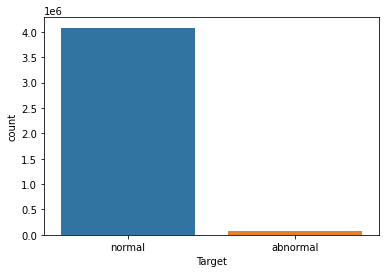

In [128]:
sns.countplot(x = df['Target'])

In [129]:
df['Col1'].value_counts()

1123030909    393
1123030803    361
1123030908    333
1127243396    322
1123031057    313
             ... 
1131228406      1
1131228458      1
1131228473      1
1131228548      1
1123993468      1
Name: Col1, Length: 226288, dtype: int64

In [125]:
df['Info'].value_counts()

NULL                   88949
R30-M0-N9-C:J16-U01    67058
R02-M1-N0-C:J12-U11    64630
UNKNOWN_LOCATION       26610
R16-M1-N2-C:J17-U01    16915
                       ...  
R65-M0-NB                  1
R32-M1-S                   1
R13-M0-NB                  1
R14-M1                     1
R20-M0-L2                  1
Name: Info, Length: 69235, dtype: int64

In [ ]:
sns.countplot(x = df['Info'].value_counts())

In [444]:
df[(df['Target']=='normal') & (df['Date'] == '2005.06.11')]

,1,Date,Info,UID,Info2,Error,Target
219878,1118489526,2005.06.11,R26-M0-N0-C:J14-U01,2005-06-11-04.32.06.752058,R26-M0-N0-C:J14-U01,RAS KERNEL INFO 4711888 L3 EDRAM error(s) (dcr...,normal
219879,1118489526,2005.06.11,R26-M0-N0-C:J14-U01,2005-06-11-04.32.06.765282,R26-M0-N0-C:J14-U01,RAS KERNEL INFO 4711888 L3 EDRAM error(s) (dcr...,normal
219880,1118502032,2005.06.11,R27-M1-L3-U18-C,2005-06-11-08.00.32.919329,R27-M1-L3-U18-C,RAS LINKCARD INFO MidplaneSwitchController per...,normal
219881,1118502558,2005.06.11,R27-M1-L3-U18-C,2005-06-11-08.09.18.347068,R27-M1-L3-U18-C,RAS LINKCARD INFO MidplaneSwitchController per...,normal
219882,1118503053,2005.06.11,R26-M0-N0-C:J14-U01,2005-06-11-08.17.33.918161,R26-M0-N0-C:J14-U01,RAS KERNEL INFO 723 L3 EDRAM error(s) (dcr 0x0...,normal
...,...,...,...,...,...,...,...
220359,1118558395,2005.06.11,NULL,2005-06-11-23.39.55.755393,NULL,RAS MMCS INFO idoproxydb has been started: $Na...,normal
220360,1118558396,2005.06.11,NULL,2005-06-11-23.39.56.159912,NULL,RAS MMCS INFO mmcs_db_server has been started:...,normal
220361,1118558396,2005.06.11,NULL,2005-06-11-23.39.56.165228,NULL,RAS MMCS INFO ciodb has been restarted.,normal
220362,1118558886,2005.06.11,R27-M1-L3-U18-C,2005-06-11-23.48.06.043964,R27-M1-L3-U18-C,RAS LINKCARD INFO MidplaneSwitchController per...,normal


In [443]:
df[(df['Target']=='abnormal') & (df['Date'] == '2005.06.11')]

,1,Date,Info,UID,Info2,Error,Target
4085742,1118535464,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-17.17.44.605961,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL machine check interrupt (bit=...,abnormal
4085743,1118535464,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-17.17.44.898186,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4085744,1118535465,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-17.17.45.004402,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4085745,1118535465,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-17.17.45.103186,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4085746,1118535465,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-17.17.45.353061,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
...,...,...,...,...,...,...,...
4152654,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.386651,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152655,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.558220,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152656,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.675784,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152657,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.777307,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal


In [307]:
abnormal_list = list(abnormal_vals)

In [315]:
for error in abnormal_list:
    if 'RAS KERNEL FATAL machine check interrupt' in error:
        abnormal_list.remove(error)

In [316]:
abnormal_list

['RAS KERNEL FATAL data TLB error interrupt',
 'RAS KERNEL FATAL DDR machine check register: 0x00000000 0x00010000',
 'RAS KERNEL FATAL machine check interrupt',
 'RAS KERNEL FATAL rts panic! - stopping execution',
 'RAS APP FATAL ciod: failed to read message prefix on control stream']

In [453]:
labels = []
i = 0
for error in testlog:
    if any(val in error for val in abnormal_list) or '2005.06.11' in error:
        labels.append('abnormal')
    else:
        labels.append('normal')

In [304]:
for index, row in df.iterrows():
    error = row['Error']
    print(error)
    if any(val in error for val in abnormal_vals):
        print(row['Date'], row['Error'])

RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cac

RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cac

RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cache parity error corrected
RAS KERNEL INFO instruction cac

RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 222 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 141 double-hummer alignment exceptions
RAS KERNEL INFO 201 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 141 double-hummer alignment exceptions
RAS KERNEL INFO 141 double-hummer alignment exceptions
RAS KERNEL INFO 122 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 202 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 222 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 222 double-hummer alignment exceptions
RAS KERNEL INFO 142 double-hummer alignment exceptions
RAS KERNEL

RAS KERNEL INFO 101 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 161 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL INFO 121 double-hummer alignment exceptions
RAS KERNEL INFO 142 double-hummer alignment exceptions
RAS KERNEL INFO 181 double-hummer alignment exceptions
RAS KERNEL INFO 162 double-hummer alignment exceptions
RAS KERNEL INFO 141 double-hummer alignment exceptions
RAS KERNEL INFO 161 double-hummer alignment exceptions
RAS KERNEL INFO 102 double-hummer alignment exceptions
RAS KERNEL INFO 201 double-hummer alignment exceptions
RAS KERNEL INFO 202 double-hummer alignment exceptions
RAS KERNEL INFO 162 double-hummer alignment exceptions
RAS KERNEL INFO 182 double-hummer alignment exceptions
RAS KERNEL

RAS KERNEL INFO generating core.2275
RAS KERNEL INFO generating core.2283
RAS KERNEL INFO generating core.2552
RAS KERNEL INFO generating core.2553
RAS KERNEL INFO generating core.2547
RAS KERNEL INFO generating core.2555
RAS KERNEL INFO generating core.2554
RAS KERNEL INFO generating core.2544
RAS KERNEL INFO generating core.2545
RAS KERNEL INFO generating core.2410
RAS KERNEL INFO generating core.2536
RAS KERNEL INFO generating core.2537
RAS KERNEL INFO generating core.2538
RAS KERNEL INFO generating core.2409
RAS KERNEL INFO generating core.2528
RAS KERNEL INFO generating core.2400
RAS KERNEL INFO generating core.2529
RAS KERNEL INFO generating core.2401
RAS KERNEL INFO generating core.2402
RAS KERNEL INFO generating core.2530
RAS KERNEL INFO generating core.2531
RAS KERNEL INFO generating core.2539
RAS KERNEL INFO generating core.2174
RAS KERNEL INFO generating core.2300
RAS KERNEL INFO generating core.2301
RAS KERNEL INFO generating core.2173
RAS KERNEL INFO generating core.2172
R

RAS KERNEL INFO generating core.3317
RAS KERNEL INFO generating core.3318
RAS KERNEL INFO generating core.3189
RAS KERNEL INFO generating core.3190
RAS KERNEL INFO generating core.3180
RAS KERNEL INFO generating core.3182
RAS KERNEL INFO generating core.3309
RAS KERNEL INFO generating core.3310
RAS KERNEL INFO generating core.3181
RAS KERNEL INFO generating core.3300
RAS KERNEL INFO generating core.3173
RAS KERNEL INFO generating core.3174
RAS KERNEL INFO generating core.3302
RAS KERNEL INFO generating core.3183
RAS KERNEL INFO generating core.3303
RAS KERNEL INFO generating core.3311
RAS KERNEL INFO generating core.3678
RAS KERNEL INFO generating core.3804
RAS KERNEL INFO generating core.3805
RAS KERNEL INFO generating core.3677
RAS KERNEL INFO generating core.3676
RAS KERNEL INFO generating core.3671
RAS KERNEL INFO generating core.3679
RAS KERNEL INFO generating core.3807
RAS KERNEL INFO generating core.3806
RAS KERNEL INFO generating core.3796
RAS KERNEL INFO generating core.3797
R

RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85f080, mask 0x0c
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85f280, mask 0x02
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85f480, mask 0x08
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85f680, mask 0x0e
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85f880, mask 0x0c
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x0fa3d060, mask 0x08
RAS KERNEL INFO CE sym 2, at 0x0b85fa80, mask 0x02
RAS KERNEL INFO CE sym 7, at 0x0d58e600, mask 0x20
RAS KERNEL INFO CE sym 2, at 0x

RAS KERNEL INFO generating core.2060
RAS KERNEL INFO generating core.2062
RAS KERNEL INFO generating core.2188
RAS KERNEL INFO generating core.2189
RAS KERNEL INFO generating core.2190
RAS KERNEL INFO generating core.2061
RAS KERNEL INFO generating core.2180
RAS KERNEL INFO generating core.2052
RAS KERNEL INFO generating core.2181
RAS KERNEL INFO generating core.2053
RAS KERNEL INFO generating core.2054
RAS KERNEL INFO generating core.2055
RAS KERNEL INFO generating core.2182
RAS KERNEL INFO generating core.2063
RAS KERNEL INFO generating core.2183
RAS KERNEL INFO generating core.2191
RAS KERNEL INFO generating core.1306
RAS KERNEL INFO generating core.1432
RAS KERNEL INFO generating core.1433
RAS KERNEL INFO generating core.1305
RAS KERNEL INFO generating core.1304
RAS KERNEL INFO generating core.1299
RAS KERNEL INFO generating core.1427
RAS KERNEL INFO generating core.1307
RAS KERNEL INFO generating core.1435
RAS KERNEL INFO generating core.1434
RAS KERNEL INFO generating core.1424
R

RAS KERNEL INFO generating core.225
RAS KERNEL INFO generating core.97
RAS KERNEL INFO generating core.98
RAS KERNEL INFO generating core.99
RAS KERNEL INFO generating core.226
RAS KERNEL INFO generating core.107
RAS KERNEL INFO generating core.227
RAS KERNEL INFO generating core.235
RAS KERNEL INFO generating core.2488
RAS KERNEL INFO generating core.2489
RAS KERNEL INFO generating core.2361
RAS KERNEL INFO generating core.2360
RAS KERNEL INFO generating core.2355
RAS KERNEL INFO generating core.2483
RAS KERNEL INFO generating core.2363
RAS KERNEL INFO generating core.2491
RAS KERNEL INFO generating core.2490
RAS KERNEL INFO generating core.2480
RAS KERNEL INFO generating core.2352
RAS KERNEL INFO generating core.2481
RAS KERNEL INFO generating core.2482
RAS KERNEL INFO generating core.2353
RAS KERNEL INFO generating core.2354
RAS KERNEL INFO generating core.2344
RAS KERNEL INFO generating core.2346
RAS KERNEL INFO generating core.2472
RAS KERNEL INFO generating core.2473
RAS KERNEL I

RAS KERNEL INFO generating core.298
RAS KERNEL INFO generating core.424
RAS KERNEL INFO generating core.425
RAS KERNEL INFO generating core.426
RAS KERNEL INFO generating core.297
RAS KERNEL INFO generating core.416
RAS KERNEL INFO generating core.288
RAS KERNEL INFO generating core.417
RAS KERNEL INFO generating core.289
RAS KERNEL INFO generating core.290
RAS KERNEL INFO generating core.291
RAS KERNEL INFO generating core.418
RAS KERNEL INFO generating core.299
RAS KERNEL INFO generating core.419
RAS KERNEL INFO generating core.427
RAS KERNEL INFO generating core.542
RAS KERNEL INFO generating core.668
RAS KERNEL INFO generating core.669
RAS KERNEL INFO generating core.541
RAS KERNEL INFO generating core.540
RAS KERNEL INFO generating core.535
RAS KERNEL INFO generating core.663
RAS KERNEL INFO generating core.543
RAS KERNEL INFO generating core.671
RAS KERNEL INFO generating core.670
RAS KERNEL INFO generating core.660
RAS KERNEL INFO generating core.532
RAS KERNEL INFO generating c

RAS KERNEL INFO generating core.120
RAS KERNEL INFO generating core.115
RAS KERNEL INFO generating core.243
RAS KERNEL INFO generating core.123
RAS KERNEL INFO generating core.251
RAS KERNEL INFO generating core.250
RAS KERNEL INFO generating core.240
RAS KERNEL INFO generating core.112
RAS KERNEL INFO generating core.241
RAS KERNEL INFO generating core.242
RAS KERNEL INFO generating core.113
RAS KERNEL INFO generating core.114
RAS KERNEL INFO generating core.104
RAS KERNEL INFO generating core.232
RAS KERNEL INFO generating core.233
RAS KERNEL INFO generating core.234
RAS KERNEL INFO generating core.105
RAS KERNEL INFO generating core.224
RAS KERNEL INFO generating core.96
RAS KERNEL INFO generating core.225
RAS KERNEL INFO generating core.97
RAS KERNEL INFO generating core.98
RAS KERNEL INFO generating core.99
RAS KERNEL INFO generating core.226
RAS KERNEL INFO generating core.107
RAS KERNEL INFO generating core.227
RAS KERNEL INFO generating core.235
RAS KERNEL INFO generating core.

RAS KERNEL INFO generating core.3716
RAS KERNEL INFO generating core.3588
RAS KERNEL INFO generating core.3717
RAS KERNEL INFO generating core.3589
RAS KERNEL INFO generating core.3590
RAS KERNEL INFO generating core.3591
RAS KERNEL INFO generating core.3718
RAS KERNEL INFO generating core.3599
RAS KERNEL INFO generating core.3719
RAS KERNEL INFO generating core.3727
RAS KERNEL INFO generating core.1850
RAS KERNEL INFO generating core.1976
RAS KERNEL INFO generating core.1977
RAS KERNEL INFO generating core.1849
RAS KERNEL INFO generating core.1848
RAS KERNEL INFO generating core.1843
RAS KERNEL INFO generating core.1971
RAS KERNEL INFO generating core.1851
RAS KERNEL INFO generating core.1979
RAS KERNEL INFO generating core.1968
RAS KERNEL INFO generating core.1840
RAS KERNEL INFO generating core.1969
RAS KERNEL INFO generating core.1970
RAS KERNEL INFO generating core.1841
RAS KERNEL INFO generating core.1842
RAS KERNEL INFO generating core.1832
RAS KERNEL INFO generating core.1834
R

RAS KERNEL INFO generating core.1606
RAS KERNEL INFO generating core.1607
RAS KERNEL INFO generating core.1734
RAS KERNEL INFO generating core.1615
RAS KERNEL INFO generating core.1735
RAS KERNEL INFO generating core.1743
RAS KERNEL INFO generating core.1626
RAS KERNEL INFO generating core.1752
RAS KERNEL INFO generating core.1753
RAS KERNEL INFO generating core.1625
RAS KERNEL INFO generating core.1624
RAS KERNEL INFO generating core.1619
RAS KERNEL INFO generating core.1747
RAS KERNEL INFO generating core.1627
RAS KERNEL INFO generating core.1755
RAS KERNEL INFO generating core.1754
RAS KERNEL INFO generating core.1744
RAS KERNEL INFO generating core.1616
RAS KERNEL INFO generating core.1745
RAS KERNEL INFO generating core.1746
RAS KERNEL INFO generating core.1617
RAS KERNEL INFO generating core.1618
RAS KERNEL INFO generating core.1608
RAS KERNEL INFO generating core.1610
RAS KERNEL INFO generating core.1736
RAS KERNEL INFO generating core.1737
RAS KERNEL INFO generating core.1738
R

RAS KERNEL INFO generating core.2937
RAS KERNEL INFO generating core.2936
RAS KERNEL INFO generating core.2931
RAS KERNEL INFO generating core.3059
RAS KERNEL INFO generating core.2939
RAS KERNEL INFO generating core.3067
RAS KERNEL INFO generating core.3066
RAS KERNEL INFO generating core.3056
RAS KERNEL INFO generating core.2928
RAS KERNEL INFO generating core.3057
RAS KERNEL INFO generating core.3058
RAS KERNEL INFO generating core.2929
RAS KERNEL INFO generating core.2930
RAS KERNEL INFO generating core.2920
RAS KERNEL INFO generating core.2922
RAS KERNEL INFO generating core.3048
RAS KERNEL INFO generating core.3049
RAS KERNEL INFO generating core.3050
RAS KERNEL INFO generating core.2921
RAS KERNEL INFO generating core.3040
RAS KERNEL INFO generating core.2912
RAS KERNEL INFO generating core.3041
RAS KERNEL INFO generating core.2913
RAS KERNEL INFO generating core.2914
RAS KERNEL INFO generating core.2915
RAS KERNEL INFO generating core.3042
RAS KERNEL INFO generating core.2923
R

RAS KERNEL INFO generating core.1214
RAS KERNEL INFO generating core.1204
RAS KERNEL INFO generating core.1205
RAS KERNEL INFO generating core.1206
RAS KERNEL INFO generating core.1077
RAS KERNEL INFO generating core.1078
RAS KERNEL INFO generating core.1068
RAS KERNEL INFO generating core.1070
RAS KERNEL INFO generating core.1196
RAS KERNEL INFO generating core.1197
RAS KERNEL INFO generating core.1198
RAS KERNEL INFO generating core.1069
RAS KERNEL INFO generating core.1188
RAS KERNEL INFO generating core.1060
RAS KERNEL INFO generating core.1189
RAS KERNEL INFO generating core.1061
RAS KERNEL INFO generating core.1063
RAS KERNEL INFO generating core.1190
RAS KERNEL INFO generating core.1071
RAS KERNEL INFO generating core.1191
RAS KERNEL INFO generating core.1199
RAS KERNEL INFO generating core.2586
RAS KERNEL INFO generating core.2712
RAS KERNEL INFO generating core.2713
RAS KERNEL INFO generating core.2585
RAS KERNEL INFO generating core.2584
RAS KERNEL INFO generating core.2579
R

RAS KERNEL INFO generating core.102
RAS KERNEL INFO generating core.47
RAS KERNEL INFO generating core.103
RAS KERNEL INFO generating core.111
RAS KERNEL INFO generating core.26
RAS KERNEL INFO generating core.88
RAS KERNEL INFO generating core.89
RAS KERNEL INFO generating core.25
RAS KERNEL INFO generating core.24
RAS KERNEL INFO generating core.19
RAS KERNEL INFO generating core.83
RAS KERNEL INFO generating core.27
RAS KERNEL INFO generating core.91
RAS KERNEL INFO generating core.90
RAS KERNEL INFO generating core.80
RAS KERNEL INFO generating core.81
RAS KERNEL INFO generating core.17
RAS KERNEL INFO generating core.18
RAS KERNEL INFO generating core.8
RAS KERNEL INFO generating core.10
RAS KERNEL INFO generating core.72
RAS KERNEL INFO generating core.73
RAS KERNEL INFO generating core.74
RAS KERNEL INFO generating core.9
RAS KERNEL INFO generating core.64
RAS KERNEL INFO generating core.0
RAS KERNEL INFO generating core.65
RAS KERNEL INFO generating core.1
RAS KERNEL INFO gener

RAS KERNEL INFO generating core.2318
RAS KERNEL INFO generating core.2061
RAS KERNEL INFO generating core.2308
RAS KERNEL INFO generating core.2052
RAS KERNEL INFO generating core.2309
RAS KERNEL INFO generating core.2053
RAS KERNEL INFO generating core.2054
RAS KERNEL INFO generating core.2055
RAS KERNEL INFO generating core.2310
RAS KERNEL INFO generating core.2063
RAS KERNEL INFO generating core.2311
RAS KERNEL INFO generating core.2319
RAS KERNEL INFO generating core.5690
RAS KERNEL INFO generating core.5944
RAS KERNEL INFO generating core.5945
RAS KERNEL INFO generating core.5689
RAS KERNEL INFO generating core.5688
RAS KERNEL INFO generating core.5683
RAS KERNEL INFO generating core.5939
RAS KERNEL INFO generating core.5691
RAS KERNEL INFO generating core.5947
RAS KERNEL INFO generating core.5946
RAS KERNEL INFO generating core.5936
RAS KERNEL INFO generating core.5680
RAS KERNEL INFO generating core.5937
RAS KERNEL INFO generating core.5938
RAS KERNEL INFO generating core.5681
R

RAS KERNEL INFO generating core.5411
RAS KERNEL INFO generating core.5419
RAS KERNEL INFO generating core.4218
RAS KERNEL INFO generating core.4472
RAS KERNEL INFO generating core.4473
RAS KERNEL INFO generating core.4217
RAS KERNEL INFO generating core.4216
RAS KERNEL INFO generating core.4211
RAS KERNEL INFO generating core.4467
RAS KERNEL INFO generating core.4219
RAS KERNEL INFO generating core.4475
RAS KERNEL INFO generating core.4474
RAS KERNEL INFO generating core.4464
RAS KERNEL INFO generating core.4208
RAS KERNEL INFO generating core.4465
RAS KERNEL INFO generating core.4466
RAS KERNEL INFO generating core.4209
RAS KERNEL INFO generating core.4210
RAS KERNEL INFO generating core.4200
RAS KERNEL INFO generating core.4202
RAS KERNEL INFO generating core.4456
RAS KERNEL INFO generating core.4457
RAS KERNEL INFO generating core.4458
RAS KERNEL INFO generating core.4201
RAS KERNEL INFO generating core.4448
RAS KERNEL INFO generating core.4192
RAS KERNEL INFO generating core.4449
R

RAS KERNEL INFO generating core.707
RAS KERNEL INFO generating core.962
RAS KERNEL INFO generating core.715
RAS KERNEL INFO generating core.963
RAS KERNEL INFO generating core.971
RAS KERNEL INFO generating core.1754
RAS KERNEL INFO generating core.2008
RAS KERNEL INFO generating core.2009
RAS KERNEL INFO generating core.1753
RAS KERNEL INFO generating core.1752
RAS KERNEL INFO generating core.1747
RAS KERNEL INFO generating core.2003
RAS KERNEL INFO generating core.1755
RAS KERNEL INFO generating core.2011
RAS KERNEL INFO generating core.2010
RAS KERNEL INFO generating core.2000
RAS KERNEL INFO generating core.1744
RAS KERNEL INFO generating core.2001
RAS KERNEL INFO generating core.2002
RAS KERNEL INFO generating core.1745
RAS KERNEL INFO generating core.1746
RAS KERNEL INFO generating core.1736
RAS KERNEL INFO generating core.1738
RAS KERNEL INFO generating core.1992
RAS KERNEL INFO generating core.1993
RAS KERNEL INFO generating core.1994
RAS KERNEL INFO generating core.1737
RAS KE

RAS KERNEL INFO generating core.8031
RAS KERNEL INFO generating core.8030
RAS KERNEL INFO generating core.8020
RAS KERNEL INFO generating core.7764
RAS KERNEL INFO generating core.8021
RAS KERNEL INFO generating core.8022
RAS KERNEL INFO generating core.7765
RAS KERNEL INFO generating core.7766
RAS KERNEL INFO generating core.7756
RAS KERNEL INFO generating core.7758
RAS KERNEL INFO generating core.8012
RAS KERNEL INFO generating core.8013
RAS KERNEL INFO generating core.8014
RAS KERNEL INFO generating core.7757
RAS KERNEL INFO generating core.8004
RAS KERNEL INFO generating core.7748
RAS KERNEL INFO generating core.8005
RAS KERNEL INFO generating core.7749
RAS KERNEL INFO generating core.7750
RAS KERNEL INFO generating core.7751
RAS KERNEL INFO generating core.8006
RAS KERNEL INFO generating core.7759
RAS KERNEL INFO generating core.8007
RAS KERNEL INFO generating core.8015
RAS KERNEL INFO generating core.6686
RAS KERNEL INFO generating core.6940
RAS KERNEL INFO generating core.6941
R

RAS KERNEL INFO generating core.1087
RAS KERNEL INFO generating core.1151
RAS KERNEL INFO generating core.1150
RAS KERNEL INFO generating core.1140
RAS KERNEL INFO generating core.1076
RAS KERNEL INFO generating core.1141
RAS KERNEL INFO generating core.1142
RAS KERNEL INFO generating core.1077
RAS KERNEL INFO generating core.1078
RAS KERNEL INFO generating core.1068
RAS KERNEL INFO generating core.1070
RAS KERNEL INFO generating core.1132
RAS KERNEL INFO generating core.1133
RAS KERNEL INFO generating core.1134
RAS KERNEL INFO generating core.1069
RAS KERNEL INFO generating core.1124
RAS KERNEL INFO generating core.1060
RAS KERNEL INFO generating core.1125
RAS KERNEL INFO generating core.1061
RAS KERNEL INFO generating core.1062
RAS KERNEL INFO generating core.1063
RAS KERNEL INFO generating core.1126
RAS KERNEL INFO generating core.1071
RAS KERNEL INFO generating core.1127
RAS KERNEL INFO generating core.1135
RAS KERNEL INFO generating core.30
RAS KERNEL INFO generating core.92
RAS K

RAS KERNEL INFO generating core.796
RAS KERNEL INFO generating core.799
RAS KERNEL INFO generating core.863
RAS KERNEL INFO generating core.862
RAS KERNEL INFO generating core.788
RAS KERNEL INFO generating core.836
RAS KERNEL INFO generating core.772
RAS KERNEL INFO generating core.774
RAS KERNEL INFO generating core.775
RAS KERNEL INFO generating core.783
RAS KERNEL INFO generating core.839
RAS KERNEL INFO generating core.318
RAS KERNEL INFO generating core.380
RAS KERNEL INFO generating core.381
RAS KERNEL INFO generating core.317
RAS KERNEL INFO generating core.316
RAS KERNEL INFO generating core.319
RAS KERNEL INFO generating core.383
RAS KERNEL INFO generating core.382
RAS KERNEL INFO generating core.372
RAS KERNEL INFO generating core.308
RAS KERNEL INFO generating core.309
RAS KERNEL INFO generating core.300
RAS KERNEL INFO generating core.364
RAS KERNEL INFO generating core.292
RAS KERNEL INFO generating core.293
RAS KERNEL INFO generating core.295
RAS KERNEL INFO generating c

RAS KERNEL INFO generating core.1595
RAS KERNEL INFO generating core.1851
RAS KERNEL INFO generating core.1850
RAS KERNEL INFO generating core.1841
RAS KERNEL INFO generating core.1576
RAS KERNEL INFO generating core.1832
RAS KERNEL INFO generating core.1834
RAS KERNEL INFO generating core.1568
RAS KERNEL INFO generating core.1825
RAS KERNEL INFO generating core.1569
RAS KERNEL INFO generating core.1570
RAS KERNEL INFO generating core.1571
RAS KERNEL INFO generating core.7358
RAS KERNEL INFO generating core.7612
RAS KERNEL INFO generating core.7351
RAS KERNEL INFO generating core.7604
RAS KERNEL INFO generating core.7348
RAS KERNEL INFO generating core.7605
RAS KERNEL INFO generating core.7350
RAS KERNEL INFO generating core.7342
RAS KERNEL INFO generating core.7596
RAS KERNEL INFO generating core.7597
RAS KERNEL INFO generating core.7332
RAS KERNEL INFO generating core.7335
RAS KERNEL INFO generating core.7599
RAS KERNEL INFO generating core.7609
RAS KERNEL INFO generating core.7353
R

RAS KERNEL INFO generating core.5269
RAS KERNEL INFO generating core.5270
RAS KERNEL INFO generating core.5260
RAS KERNEL INFO generating core.5262
RAS KERNEL INFO generating core.5516
RAS KERNEL INFO generating core.5518
RAS KERNEL INFO generating core.5261
RAS KERNEL INFO generating core.5508
RAS KERNEL INFO generating core.5253
RAS KERNEL INFO generating core.5254
RAS KERNEL INFO generating core.5255
RAS KERNEL INFO generating core.5510
RAS KERNEL INFO generating core.5263
RAS KERNEL INFO generating core.5511
RAS KERNEL INFO generating core.5519
RAS KERNEL INFO generating core.3480
RAS KERNEL INFO generating core.3225
RAS KERNEL INFO generating core.3219
RAS KERNEL INFO generating core.3475
RAS KERNEL INFO generating core.3227
RAS KERNEL INFO generating core.3483
RAS KERNEL INFO generating core.3216
RAS KERNEL INFO generating core.3474
RAS KERNEL INFO generating core.3210
RAS KERNEL INFO generating core.3464
RAS KERNEL INFO generating core.3466
RAS KERNEL INFO generating core.3209
R

RAS KERNEL INFO generating core.5108
RAS KERNEL INFO generating core.4852
RAS KERNEL INFO generating core.5109
RAS KERNEL INFO generating core.5110
RAS KERNEL INFO generating core.4853
RAS KERNEL INFO generating core.4846
RAS KERNEL INFO generating core.5100
RAS KERNEL INFO generating core.5101
RAS KERNEL INFO generating core.4845
RAS KERNEL INFO generating core.5092
RAS KERNEL INFO generating core.4836
RAS KERNEL INFO generating core.4837
RAS KERNEL INFO generating core.4839
RAS KERNEL INFO generating core.5095
RAS KERNEL INFO generating core.6846
RAS KERNEL INFO generating core.7100
RAS KERNEL INFO generating core.6845
RAS KERNEL INFO generating core.6839
RAS KERNEL INFO generating core.7095
RAS KERNEL INFO generating core.6847
RAS KERNEL INFO generating core.7103
RAS KERNEL INFO generating core.7102
RAS KERNEL INFO generating core.7093
RAS KERNEL INFO generating core.7094
RAS KERNEL INFO generating core.6837
RAS KERNEL INFO generating core.6838
RAS KERNEL INFO generating core.6828
R

RAS KERNEL INFO generating core.2117
RAS KERNEL INFO generating core.2118
RAS KERNEL INFO generating core.2119
RAS KERNEL INFO generating core.2374
RAS KERNEL INFO generating core.2127
RAS KERNEL INFO generating core.2383
RAS KERNEL INFO generating core.7194
RAS KERNEL INFO generating core.7448
RAS KERNEL INFO generating core.7192
RAS KERNEL INFO generating core.7443
RAS KERNEL INFO generating core.7195
RAS KERNEL INFO generating core.7451
RAS KERNEL INFO generating core.7441
RAS KERNEL INFO generating core.7185
RAS KERNEL INFO generating core.7186
RAS KERNEL INFO generating core.7178
RAS KERNEL INFO generating core.7432
RAS KERNEL INFO generating core.7434
RAS KERNEL INFO generating core.7177
RAS KERNEL INFO generating core.7168
RAS KERNEL INFO generating core.7169
RAS KERNEL INFO generating core.7170
RAS KERNEL INFO generating core.7171
RAS KERNEL INFO generating core.7179
RAS KERNEL INFO generating core.7427
RAS KERNEL INFO generating core.7435
RAS KERNEL INFO generating core.4154
R

RAS KERNEL FATAL external input interrupt enable...0
RAS KERNEL FATAL problem state (0=sup,1=usr).......0
RAS KERNEL FATAL floating point instr. enabled.....1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL floating pt ex mode 0 enable......0
RAS KERNEL FATAL debug wait enable.................0
RAS KERNEL FATAL debug interrupt enable............0
RAS KERNEL FATAL floating pt ex mode 1 enable......0
RAS KERNEL FATAL instruction address space.........0
RAS KERNEL FATAL data address space................0
RAS KERNEL FATAL core configuration register: 0x00002000
RAS KERNEL FATAL disable store gathering..................0
RAS KERNEL FATAL disable apu instruction broadcast........0
RAS KERNEL FATAL disable trace broadcast..................0
RAS KERNEL FATAL guaranteed instruction cache block touch.0
RAS KERNEL FATAL guaranteed data cache block touch........1
RAS KERNEL FATAL force load/store alignment...............0
RAS KERNEL FATAL icache prefetch depth...............

RAS KERNEL INFO generating core.8769
RAS KERNEL INFO generating core.8258
RAS KERNEL INFO generating core.8259
RAS KERNEL INFO generating core.8275
RAS KERNEL INFO generating core.8787
RAS KERNEL INFO generating core.6262
RAS KERNEL INFO generating core.6772
RAS KERNEL INFO generating core.6773
RAS KERNEL INFO generating core.6775
RAS KERNEL INFO generating core.6756
RAS KERNEL INFO generating core.6244
RAS KERNEL INFO generating core.6246
RAS KERNEL INFO generating core.6230
RAS KERNEL INFO generating core.6741
RAS KERNEL INFO generating core.6215
RAS KERNEL INFO generating core.6726
RAS KERNEL INFO generating core.6727
RAS KERNEL INFO generating core.9266
RAS KERNEL INFO generating core.9777
RAS KERNEL INFO generating core.9265
RAS KERNEL INFO generating core.9264
RAS KERNEL INFO generating core.9251
RAS KERNEL INFO generating core.9763
RAS KERNEL INFO generating core.9267
RAS KERNEL INFO generating core.9779
RAS KERNEL INFO generating core.9248
RAS KERNEL INFO generating core.9761
R

RAS KERNEL INFO generating core.9116
RAS KERNEL INFO generating core.9117
RAS KERNEL INFO generating core.9118
RAS KERNEL INFO generating core.8605
RAS KERNEL INFO generating core.8588
RAS KERNEL INFO generating core.9101
RAS KERNEL INFO generating core.8589
RAS KERNEL INFO generating core.8590
RAS KERNEL INFO generating core.8591
RAS KERNEL INFO generating core.9103
RAS KERNEL INFO generating core.9119
RAS KERNEL INFO generating core.10161
RAS KERNEL INFO generating core.9648
RAS KERNEL INFO generating core.9635
RAS KERNEL INFO generating core.10163
RAS KERNEL INFO generating core.10144
RAS KERNEL INFO generating core.9633
RAS KERNEL INFO generating core.9616
RAS KERNEL INFO generating core.9618
RAS KERNEL INFO generating core.10129
RAS KERNEL INFO generating core.10112
RAS KERNEL INFO generating core.9600
RAS KERNEL INFO generating core.10113
RAS KERNEL INFO generating core.9602
RAS KERNEL INFO generating core.10131
RAS KERNEL INFO generating core.2936
RAS KERNEL INFO generating core

RAS KERNEL INFO generating core.84
RAS KERNEL INFO generating core.20
RAS KERNEL INFO generating core.85
RAS KERNEL INFO generating core.86
RAS KERNEL INFO generating core.21
RAS KERNEL INFO generating core.22
RAS KERNEL INFO generating core.68
RAS KERNEL INFO generating core.4
RAS KERNEL INFO generating core.5
RAS KERNEL INFO generating core.6
RAS KERNEL INFO generating core.7
RAS KERNEL INFO generating core.70
RAS KERNEL INFO generating core.275
RAS KERNEL INFO generating core.339
RAS KERNEL INFO generating core.336
RAS KERNEL INFO generating core.337
RAS KERNEL INFO generating core.338
RAS KERNEL INFO generating core.273
RAS KERNEL INFO generating core.274
RAS KERNEL INFO generating core.320
RAS KERNEL INFO generating core.256
RAS KERNEL INFO generating core.321
RAS KERNEL INFO generating core.257
RAS KERNEL INFO generating core.258
RAS KERNEL INFO generating core.259
RAS KERNEL INFO generating core.322
RAS KERNEL INFO generating core.323
RAS KERNEL INFO generating core.435
RAS KERN

RAS KERNEL INFO generating core.4694
RAS KERNEL INFO generating core.4684
RAS KERNEL INFO generating core.4940
RAS KERNEL INFO generating core.4941
RAS KERNEL INFO generating core.4942
RAS KERNEL INFO generating core.4685
RAS KERNEL INFO generating core.4932
RAS KERNEL INFO generating core.4676
RAS KERNEL INFO generating core.4677
RAS KERNEL INFO generating core.4679
RAS KERNEL INFO generating core.4943
RAS KERNEL INFO generating core.2686
RAS KERNEL INFO generating core.2940
RAS KERNEL INFO generating core.2685
RAS KERNEL INFO generating core.2684
RAS KERNEL INFO generating core.2943
RAS KERNEL INFO generating core.2942
RAS KERNEL INFO generating core.2932
RAS KERNEL INFO generating core.2677
RAS KERNEL INFO generating core.2670
RAS KERNEL INFO generating core.2924
RAS KERNEL INFO generating core.2925
RAS KERNEL INFO generating core.2926
RAS KERNEL INFO generating core.2669
RAS KERNEL INFO generating core.2662
RAS KERNEL INFO generating core.2671
RAS KERNEL INFO generating core.2919
R

RAS KERNEL INFO generating core.2480
RAS KERNEL INFO generating core.2224
RAS KERNEL INFO generating core.2481
RAS KERNEL INFO generating core.2482
RAS KERNEL INFO generating core.2225
RAS KERNEL INFO generating core.2226
RAS KERNEL INFO generating core.2464
RAS KERNEL INFO generating core.2208
RAS KERNEL INFO generating core.2465
RAS KERNEL INFO generating core.2209
RAS KERNEL INFO generating core.2210
RAS KERNEL INFO generating core.2211
RAS KERNEL INFO generating core.2466
RAS KERNEL INFO generating core.2467
RAS KERNEL INFO generating core.1047
RAS KERNEL INFO generating core.1303
RAS KERNEL INFO generating core.1300
RAS KERNEL INFO generating core.1044
RAS KERNEL INFO generating core.1301
RAS KERNEL INFO generating core.1302
RAS KERNEL INFO generating core.1045
RAS KERNEL INFO generating core.1046
RAS KERNEL INFO generating core.1284
RAS KERNEL INFO generating core.1028
RAS KERNEL INFO generating core.1285
RAS KERNEL INFO generating core.1029
RAS KERNEL INFO generating core.1030
R

RAS KERNEL INFO generating core.4001
RAS KERNEL INFO generating core.3745
RAS KERNEL INFO generating core.3746
RAS KERNEL INFO generating core.4003
RAS KERNEL INFO generating core.6291
RAS KERNEL INFO generating core.6547
RAS KERNEL INFO generating core.6288
RAS KERNEL INFO generating core.6545
RAS KERNEL INFO generating core.6546
RAS KERNEL INFO generating core.6289
RAS KERNEL INFO generating core.6290
RAS KERNEL INFO generating core.6528
RAS KERNEL INFO generating core.6272
RAS KERNEL INFO generating core.6529
RAS KERNEL INFO generating core.6273
RAS KERNEL INFO generating core.6274
RAS KERNEL INFO generating core.6275
RAS KERNEL INFO generating core.6530
RAS KERNEL INFO generating core.6531
RAS KERNEL INFO generating core.5175
RAS KERNEL INFO generating core.5428
RAS KERNEL INFO generating core.5172
RAS KERNEL INFO generating core.5429
RAS KERNEL INFO generating core.5430
RAS KERNEL INFO generating core.5174
RAS KERNEL INFO generating core.5412
RAS KERNEL INFO generating core.5156
R

RAS KERNEL INFO generating core.289
RAS KERNEL INFO generating core.33
RAS KERNEL INFO generating core.34
RAS KERNEL INFO generating core.35
RAS KERNEL INFO generating core.290
RAS KERNEL INFO generating core.291
RAS KERNEL INFO generating core.6611
RAS KERNEL INFO generating core.6608
RAS KERNEL INFO generating core.6352
RAS KERNEL INFO generating core.6609
RAS KERNEL INFO generating core.6353
RAS KERNEL INFO generating core.6354
RAS KERNEL INFO generating core.6592
RAS KERNEL INFO generating core.6336
RAS KERNEL INFO generating core.6593
RAS KERNEL INFO generating core.6337
RAS KERNEL INFO generating core.6339
RAS KERNEL INFO generating core.6594
RAS KERNEL INFO generating core.6595
RAS KERNEL INFO generating core.7891
RAS KERNEL INFO generating core.8147
RAS KERNEL INFO generating core.8144
RAS KERNEL INFO generating core.7888
RAS KERNEL INFO generating core.8145
RAS KERNEL INFO generating core.8146
RAS KERNEL INFO generating core.7889
RAS KERNEL INFO generating core.7890
RAS KERNEL

RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable..............1
RAS KERNEL FATAL machine check enable.........

RAS KERNEL INFO generating core.5182
RAS KERNEL INFO generating core.5436
RAS KERNEL INFO generating core.5437
RAS KERNEL INFO generating core.5181
RAS KERNEL INFO generating core.5180
RAS KERNEL INFO generating core.5175
RAS KERNEL INFO generating core.5431
RAS KERNEL INFO generating core.5183
RAS KERNEL INFO generating core.5439
RAS KERNEL INFO generating core.5438
RAS KERNEL INFO generating core.5428
RAS KERNEL INFO generating core.5172
RAS KERNEL INFO generating core.5429
RAS KERNEL INFO generating core.5430
RAS KERNEL INFO generating core.5173
RAS KERNEL INFO generating core.5174
RAS KERNEL INFO generating core.5164
RAS KERNEL INFO generating core.5166
RAS KERNEL INFO generating core.5420
RAS KERNEL INFO generating core.5421
RAS KERNEL INFO generating core.5422
RAS KERNEL INFO generating core.5165
RAS KERNEL INFO generating core.5412
RAS KERNEL INFO generating core.5156
RAS KERNEL INFO generating core.5413
RAS KERNEL INFO generating core.5158
RAS KERNEL INFO generating core.5159
R

RAS KERNEL INFO generating core.4051
RAS KERNEL INFO generating core.3803
RAS KERNEL INFO generating core.4059
RAS KERNEL INFO generating core.4058
RAS KERNEL INFO generating core.4048
RAS KERNEL INFO generating core.3792
RAS KERNEL INFO generating core.4049
RAS KERNEL INFO generating core.4050
RAS KERNEL INFO generating core.3793
RAS KERNEL INFO generating core.3794
RAS KERNEL INFO generating core.3784
RAS KERNEL INFO generating core.3786
RAS KERNEL INFO generating core.4040
RAS KERNEL INFO generating core.4041
RAS KERNEL INFO generating core.4042
RAS KERNEL INFO generating core.3785
RAS KERNEL INFO generating core.4032
RAS KERNEL INFO generating core.3776
RAS KERNEL INFO generating core.4033
RAS KERNEL INFO generating core.3777
RAS KERNEL INFO generating core.3778
RAS KERNEL INFO generating core.3779
RAS KERNEL INFO generating core.4034
RAS KERNEL INFO generating core.3787
RAS KERNEL INFO generating core.4035
RAS KERNEL INFO generating core.4043
RAS KERNEL INFO generating core.1626
R

RAS KERNEL INFO generating core.827
RAS KERNEL INFO generating core.826
RAS KERNEL INFO generating core.816
RAS KERNEL INFO generating core.560
RAS KERNEL INFO generating core.818
RAS KERNEL INFO generating core.561
RAS KERNEL INFO generating core.562
RAS KERNEL INFO generating core.552
RAS KERNEL INFO generating core.554
RAS KERNEL INFO generating core.808
RAS KERNEL INFO generating core.809
RAS KERNEL INFO generating core.810
RAS KERNEL INFO generating core.553
RAS KERNEL INFO generating core.800
RAS KERNEL INFO generating core.544
RAS KERNEL INFO generating core.801
RAS KERNEL INFO generating core.545
RAS KERNEL INFO generating core.546
RAS KERNEL INFO generating core.547
RAS KERNEL INFO generating core.802
RAS KERNEL INFO generating core.555
RAS KERNEL INFO generating core.803
RAS KERNEL INFO generating core.811
RAS KERNEL INFO generating core.3262
RAS KERNEL INFO generating core.3516
RAS KERNEL INFO generating core.3517
RAS KERNEL INFO generating core.3261
RAS KERNEL INFO generati

RAS KERNEL INFO generating core.5005
RAS KERNEL INFO generating core.5006
RAS KERNEL INFO generating core.4749
RAS KERNEL INFO generating core.4996
RAS KERNEL INFO generating core.4740
RAS KERNEL INFO generating core.4997
RAS KERNEL INFO generating core.4741
RAS KERNEL INFO generating core.4742
RAS KERNEL INFO generating core.4743
RAS KERNEL INFO generating core.4751
RAS KERNEL INFO generating core.4999
RAS KERNEL INFO generating core.5007
RAS KERNEL INFO generating core.5854
RAS KERNEL INFO generating core.6108
RAS KERNEL INFO generating core.6109
RAS KERNEL INFO generating core.5853
RAS KERNEL INFO generating core.5852
RAS KERNEL INFO generating core.5847
RAS KERNEL INFO generating core.6103
RAS KERNEL INFO generating core.5855
RAS KERNEL INFO generating core.6111
RAS KERNEL INFO generating core.6110
RAS KERNEL INFO generating core.6100
RAS KERNEL INFO generating core.5844
RAS KERNEL INFO generating core.6101
RAS KERNEL INFO generating core.6102
RAS KERNEL INFO generating core.5845
R

RAS KERNEL INFO generating core.2625
RAS KERNEL INFO generating core.2882
RAS KERNEL INFO generating core.2635
RAS KERNEL INFO generating core.2883
RAS KERNEL INFO generating core.3738
RAS KERNEL INFO generating core.3992
RAS KERNEL INFO generating core.3993
RAS KERNEL INFO generating core.3737
RAS KERNEL INFO generating core.3736
RAS KERNEL INFO generating core.3995
RAS KERNEL INFO generating core.3986
RAS KERNEL INFO generating core.3730
RAS KERNEL INFO generating core.3722
RAS KERNEL INFO generating core.3968
RAS KERNEL INFO generating core.3712
RAS KERNEL INFO generating core.3713
RAS KERNEL INFO generating core.3714
RAS KERNEL INFO generating core.3970
RAS KERNEL INFO generating core.3723
RAS KERNEL INFO generating core.3971
RAS KERNEL INFO generating core.6072
RAS KERNEL INFO generating core.6073
RAS KERNEL INFO generating core.5816
RAS KERNEL INFO generating core.6074
RAS KERNEL INFO generating core.6064
RAS KERNEL INFO generating core.5801
RAS KERNEL INFO generating core.6048
R

RAS KERNEL INFO generating core.3458
RAS KERNEL INFO generating core.3459
RAS KERNEL INFO generating core.3467
RAS KERNEL INFO generating core.1341
RAS KERNEL INFO generating core.1085
RAS KERNEL INFO generating core.1084
RAS KERNEL INFO generating core.1079
RAS KERNEL INFO generating core.1087
RAS KERNEL INFO generating core.1342
RAS KERNEL INFO generating core.1332
RAS KERNEL INFO generating core.1076
RAS KERNEL INFO generating core.1078
RAS KERNEL INFO generating core.1068
RAS KERNEL INFO generating core.1070
RAS KERNEL INFO generating core.1325
RAS KERNEL INFO generating core.1069
RAS KERNEL INFO generating core.1316
RAS KERNEL INFO generating core.1317
RAS KERNEL INFO generating core.1061
RAS KERNEL INFO generating core.1318
RAS KERNEL INFO generating core.1071
RAS KERNEL INFO generating core.1327
RAS KERNEL INFO generating core.4250
RAS KERNEL INFO generating core.4249
RAS KERNEL INFO generating core.4507
RAS KERNEL INFO generating core.4506
RAS KERNEL INFO generating core.4496
R

RAS KERNEL INFO generating core.6849
RAS KERNEL INFO generating core.6850
RAS KERNEL INFO generating core.6851
RAS KERNEL INFO generating core.7106
RAS KERNEL INFO generating core.7107
RAS KERNEL INFO generating core.7115
RAS KERNEL INFO generating core.7160
RAS KERNEL INFO generating core.6904
RAS KERNEL INFO generating core.6899
RAS KERNEL INFO generating core.7155
RAS KERNEL INFO generating core.6897
RAS KERNEL INFO generating core.6898
RAS KERNEL INFO generating core.6890
RAS KERNEL INFO generating core.7145
RAS KERNEL INFO generating core.7146
RAS KERNEL INFO generating core.7136
RAS KERNEL INFO generating core.6880
RAS KERNEL INFO generating core.6881
RAS KERNEL INFO generating core.6882
RAS KERNEL INFO generating core.7139
RAS KERNEL INFO generating core.7390
RAS KERNEL INFO generating core.7644
RAS KERNEL INFO generating core.7639
RAS KERNEL INFO generating core.7647
RAS KERNEL INFO generating core.7646
RAS KERNEL INFO generating core.7636
RAS KERNEL INFO generating core.7380
R

RAS KERNEL INFO generating core.7574
RAS KERNEL INFO generating core.7317
RAS KERNEL INFO generating core.7318
RAS KERNEL INFO generating core.7310
RAS KERNEL INFO generating core.7309
RAS KERNEL INFO generating core.7301
RAS KERNEL INFO generating core.7302
RAS KERNEL INFO generating core.7558
RAS KERNEL INFO generating core.7559
RAS KERNEL INFO generating core.7567
RAS KERNEL INFO generating core.3129
RAS KERNEL INFO generating core.3387
RAS KERNEL INFO generating core.3386
RAS KERNEL INFO generating core.3378
RAS KERNEL INFO generating core.3114
RAS KERNEL INFO generating core.3370
RAS KERNEL INFO generating core.3105
RAS KERNEL INFO generating core.3362
RAS KERNEL INFO generating core.3115
RAS KERNEL INFO generating core.188
RAS KERNEL INFO generating core.191
RAS KERNEL INFO generating core.446
RAS KERNEL INFO generating core.436
RAS KERNEL INFO generating core.437
RAS KERNEL INFO generating core.181
RAS KERNEL INFO generating core.182
RAS KERNEL INFO generating core.172
RAS KERNE

RAS KERNEL INFO generating core.4071
RAS KERNEL INFO generating core.4079
RAS KERNEL INFO generating core.5724
RAS KERNEL INFO generating core.5727
RAS KERNEL INFO generating core.5982
RAS KERNEL INFO generating core.5972
RAS KERNEL INFO generating core.5974
RAS KERNEL INFO generating core.5718
RAS KERNEL INFO generating core.5710
RAS KERNEL INFO generating core.5965
RAS KERNEL INFO generating core.5966
RAS KERNEL INFO generating core.5709
RAS KERNEL INFO generating core.5956
RAS KERNEL INFO generating core.5957
RAS KERNEL INFO generating core.5702
RAS KERNEL INFO generating core.5703
RAS KERNEL INFO generating core.5958
RAS KERNEL INFO generating core.5711
RAS KERNEL INFO generating core.5959
RAS KERNEL INFO generating core.5967
RAS KERNEL INFO generating core.4956
RAS KERNEL INFO generating core.4701
RAS KERNEL INFO generating core.4959
RAS KERNEL INFO generating core.4958
RAS KERNEL INFO generating core.4692
RAS KERNEL INFO generating core.4950
RAS KERNEL INFO generating core.4693
R

RAS KERNEL INFO generating core.1335
RAS KERNEL INFO generating core.1343
RAS KERNEL INFO generating core.1342
RAS KERNEL INFO generating core.1076
RAS KERNEL INFO generating core.1333
RAS KERNEL INFO generating core.1078
RAS KERNEL INFO generating core.1068
RAS KERNEL INFO generating core.1070
RAS KERNEL INFO generating core.1324
RAS KERNEL INFO generating core.1325
RAS KERNEL INFO generating core.1326
RAS KERNEL INFO generating core.1316
RAS KERNEL INFO generating core.1060
RAS KERNEL INFO generating core.1317
RAS KERNEL INFO generating core.4250
RAS KERNEL INFO generating core.4504
RAS KERNEL INFO generating core.4505
RAS KERNEL INFO generating core.4249
RAS KERNEL INFO generating core.4248
RAS KERNEL INFO generating core.4499
RAS KERNEL INFO generating core.4251
RAS KERNEL INFO generating core.4507
RAS KERNEL INFO generating core.4506
RAS KERNEL INFO generating core.4496
RAS KERNEL INFO generating core.4240
RAS KERNEL INFO generating core.4497
RAS KERNEL INFO generating core.4241
R

RAS KERNEL INFO generating core.52
RAS KERNEL INFO generating core.309
RAS KERNEL INFO generating core.54
RAS KERNEL INFO generating core.46
RAS KERNEL INFO generating core.300
RAS KERNEL INFO generating core.301
RAS KERNEL INFO generating core.45
RAS KERNEL INFO generating core.292
RAS KERNEL INFO generating core.36
RAS KERNEL INFO generating core.293
RAS KERNEL INFO generating core.222
RAS KERNEL INFO generating core.221
RAS KERNEL INFO generating core.220
RAS KERNEL INFO generating core.215
RAS KERNEL INFO generating core.223
RAS KERNEL INFO generating core.479
RAS KERNEL INFO generating core.468
RAS KERNEL INFO generating core.212
RAS KERNEL INFO generating core.469
RAS KERNEL INFO generating core.204
RAS KERNEL INFO generating core.460
RAS KERNEL INFO generating core.461
RAS KERNEL INFO generating core.452
RAS KERNEL INFO generating core.453
RAS KERNEL INFO generating core.198
RAS KERNEL INFO generating core.218
RAS KERNEL INFO generating core.472
RAS KERNEL INFO generating core.4

RAS KERNEL INFO generating core.2324
RAS KERNEL INFO generating core.2068
RAS KERNEL INFO generating core.2325
RAS KERNEL INFO generating core.2326
RAS KERNEL INFO generating core.2069
RAS KERNEL INFO generating core.2070
RAS KERNEL INFO generating core.2060
RAS KERNEL INFO generating core.2062
RAS KERNEL INFO generating core.2316
RAS KERNEL INFO generating core.2317
RAS KERNEL INFO generating core.2318
RAS KERNEL INFO generating core.2061
RAS KERNEL INFO generating core.2308
RAS KERNEL INFO generating core.2052
RAS KERNEL INFO generating core.2309
RAS KERNEL INFO generating core.2053
RAS KERNEL INFO generating core.2054
RAS KERNEL INFO generating core.2055
RAS KERNEL INFO generating core.2310
RAS KERNEL INFO generating core.2063
RAS KERNEL INFO generating core.2311
RAS KERNEL INFO generating core.2319
RAS KERNEL INFO generating core.5690
RAS KERNEL INFO generating core.5944
RAS KERNEL INFO generating core.5945
RAS KERNEL INFO generating core.5689
RAS KERNEL INFO generating core.5688
R

RAS KERNEL INFO generating core.1110
RAS KERNEL INFO generating core.1100
RAS KERNEL INFO generating core.1102
RAS KERNEL INFO generating core.1356
RAS KERNEL INFO generating core.1357
RAS KERNEL INFO generating core.1358
RAS KERNEL INFO generating core.1101
RAS KERNEL INFO generating core.1348
RAS KERNEL INFO generating core.1092
RAS KERNEL INFO generating core.1349
RAS KERNEL INFO generating core.1093
RAS KERNEL INFO generating core.1094
RAS KERNEL INFO generating core.1095
RAS KERNEL INFO generating core.1350
RAS KERNEL INFO generating core.1103
RAS KERNEL INFO generating core.1351
RAS KERNEL INFO generating core.1359
RAS KERNEL INFO generating core.5178
RAS KERNEL INFO generating core.5432
RAS KERNEL INFO generating core.5433
RAS KERNEL INFO generating core.5177
RAS KERNEL INFO generating core.5176
RAS KERNEL INFO generating core.5171
RAS KERNEL INFO generating core.5179
RAS KERNEL INFO generating core.5435
RAS KERNEL INFO generating core.5434
RAS KERNEL INFO generating core.5424
R

RAS KERNEL INFO generating core.480
RAS KERNEL INFO generating core.224
RAS KERNEL INFO generating core.225
RAS KERNEL INFO generating core.226
RAS KERNEL INFO generating core.227
RAS KERNEL INFO generating core.482
RAS KERNEL INFO generating core.235
RAS KERNEL INFO generating core.483
RAS KERNEL INFO generating core.1786
RAS KERNEL INFO generating core.2040
RAS KERNEL INFO generating core.2041
RAS KERNEL INFO generating core.1785
RAS KERNEL INFO generating core.1784
RAS KERNEL INFO generating core.1779
RAS KERNEL INFO generating core.2035
RAS KERNEL INFO generating core.1787
RAS KERNEL INFO generating core.2043
RAS KERNEL INFO generating core.2042
RAS KERNEL INFO generating core.2032
RAS KERNEL INFO generating core.1776
RAS KERNEL INFO generating core.2033
RAS KERNEL INFO generating core.2034
RAS KERNEL INFO generating core.1777
RAS KERNEL INFO generating core.1778
RAS KERNEL INFO generating core.1768
RAS KERNEL INFO generating core.1770
RAS KERNEL INFO generating core.2025
RAS KERNE

RAS KERNEL INFO generating core.5940
RAS KERNEL INFO generating core.5684
RAS KERNEL INFO generating core.5941
RAS KERNEL INFO generating core.5942
RAS KERNEL INFO generating core.5685
RAS KERNEL INFO generating core.5686
RAS KERNEL INFO generating core.5678
RAS KERNEL INFO generating core.5932
RAS KERNEL INFO generating core.5933
RAS KERNEL INFO generating core.5934
RAS KERNEL INFO generating core.5924
RAS KERNEL INFO generating core.5925
RAS KERNEL INFO generating core.5670
RAS KERNEL INFO generating core.5671
RAS KERNEL INFO generating core.5926
RAS KERNEL INFO generating core.5679
RAS KERNEL INFO generating core.5927
RAS KERNEL INFO generating core.5935
RAS KERNEL INFO generating core.1790
RAS KERNEL INFO generating core.2044
RAS KERNEL INFO generating core.2045
RAS KERNEL INFO generating core.1789
RAS KERNEL INFO generating core.1788
RAS KERNEL INFO generating core.1783
RAS KERNEL INFO generating core.2039
RAS KERNEL INFO generating core.1791
RAS KERNEL INFO generating core.2047
R

RAS KERNEL INFO generating core.3121
RAS KERNEL INFO generating core.3122
RAS KERNEL INFO generating core.3112
RAS KERNEL INFO generating core.3114
RAS KERNEL INFO generating core.3368
RAS KERNEL INFO generating core.3369
RAS KERNEL INFO generating core.3113
RAS KERNEL INFO generating core.3360
RAS KERNEL INFO generating core.3104
RAS KERNEL INFO generating core.3361
RAS KERNEL INFO generating core.3105
RAS KERNEL INFO generating core.3106
RAS KERNEL INFO generating core.3362
RAS KERNEL INFO generating core.6810
RAS KERNEL INFO generating core.7064
RAS KERNEL INFO generating core.7065
RAS KERNEL INFO generating core.6809
RAS KERNEL INFO generating core.6808
RAS KERNEL INFO generating core.6803
RAS KERNEL INFO generating core.7059
RAS KERNEL INFO generating core.6811
RAS KERNEL INFO generating core.7067
RAS KERNEL INFO generating core.7066
RAS KERNEL INFO generating core.7056
RAS KERNEL INFO generating core.6800
RAS KERNEL INFO generating core.7057
RAS KERNEL INFO generating core.7058
R

RAS KERNEL INFO generating core.1904
RAS KERNEL INFO generating core.1648
RAS KERNEL INFO generating core.1905
RAS KERNEL INFO generating core.1906
RAS KERNEL INFO generating core.1649
RAS KERNEL INFO generating core.1650
RAS KERNEL INFO generating core.1640
RAS KERNEL INFO generating core.1642
RAS KERNEL INFO generating core.1896
RAS KERNEL INFO generating core.1897
RAS KERNEL INFO generating core.1898
RAS KERNEL INFO generating core.1641
RAS KERNEL INFO generating core.1888
RAS KERNEL INFO generating core.1632
RAS KERNEL INFO generating core.1889
RAS KERNEL INFO generating core.1633
RAS KERNEL INFO generating core.1634
RAS KERNEL INFO generating core.1635
RAS KERNEL INFO generating core.1890
RAS KERNEL INFO generating core.1643
RAS KERNEL INFO generating core.1891
RAS KERNEL INFO generating core.1899
RAS KERNEL INFO generating core.1146
RAS KERNEL INFO generating core.1400
RAS KERNEL INFO generating core.1401
RAS KERNEL INFO generating core.1145
RAS KERNEL INFO generating core.1144
R

KeyboardInterrupt: 

In [406]:
len(labels)

595300

In [408]:
test

,ID,Label
0,0,normal
1,1,abnormal
2,2,abnormal
3,3,normal
4,4,abnormal
...,...,...
595295,595295,normal
595296,595296,normal
595297,595297,abnormal
595298,595298,abnormal


In [454]:
test[' Label'] = labels

In [455]:
test[' Label'].value_counts()

normal      432167
abnormal    163133
Name:  Label, dtype: int64

In [456]:
test.to_csv('submission1.csv', index=False)

In [26]:
df

,1,Date,Info,UID,Info2,Error,Target
0,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.363779,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
1,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.527847,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
2,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.675872,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
3,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.823719,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
4,1117838570,2005.06.03,R02-M1-N0-C:J12-U11,2005-06-03-15.42.50.982731,R02-M1-N0-C:J12-U11,RAS KERNEL INFO instruction cache parity error...,normal
...,...,...,...,...,...,...,...
4152654,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.386651,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152655,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.558220,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152656,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.675784,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal
4152657,1118545530,2005.06.11,R30-M0-N9-C:J16-U01,2005-06-11-20.05.30.777307,R30-M0-N9-C:J16-U01,RAS KERNEL FATAL data TLB error interrupt,abnormal


In [41]:
keys = df['1'].value_counts().index.tolist()
vals = df['1'].value_counts().tolist()

In [45]:
kv = [keys, vals]

In [52]:
singleOccur = []
for k in kv:
    print(k)
    if k[1] == 1:
        singleOccur.append(k[0])

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [50]:
singleOccur

[]

In [36]:
for index, rows in df.iterrows():
    

IndentationError: expected an indented block (Temp/ipykernel_22300/623316402.py, line 1)